## Figure 3

In [ ]:
##This is for DC capacity

In [1]:
import pypsa
n=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc')

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [9]:

main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'New-Solar']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'New-Solar w Eqiuty']  ,

}



results_total_new=pd.DataFrame({})
results_generation_new=pd.DataFrame({})

hatches={'-inv-1.3':'\\', '-inv-1.5':'///', '-inv-1.7':'*','-inv-1.9' : '..', } #'+', 'x', 'o', 'O', '.', '*']

for scen in main_scen.keys():
  for  year in main_scen[scen][0]:
    scenario=scen.format(str(year))
    n=pypsa.Network(scenario)
    results_total_new.loc[ scenario, 'solar']=n.generators.p_nom_opt[n.generators.carrier=='solar'].sum()
    for  inv_ratio in ([1.5,1.7]):
        solar_tech='solar-inv-'+str(inv_ratio)
        results_total_new.loc[ scenario, solar_tech]= n.generators.p_nom_opt.filter(like=solar_tech).sum()*inv_ratio
        
    results_total_new.loc[ scenario, 'solar-hsat']=n.generators.p_nom_opt[n.generators.carrier=='solar-hsat'].sum()
    for  inv_ratio in ([1.3,1.5]):
        solar_tech='solar-hsat-inv-'+str(inv_ratio) 
        results_total_new.loc[ scenario, solar_tech]= n.generators.p_nom_opt.filter(like=solar_tech).sum()*inv_ratio    
        
    results_total_new.loc[ scenario, 'solar rooftop']=n.generators.loc[[i for i in n.generators.index 
                    if n.generators.carrier[i]=='solar rooftop' and 'inv' not in i and 'delta' not in i]].p_nom_opt.sum()      
    for  inv_ratio in ([1.5, 1.7,]):
        solar_tech='solar rooftop-inv-'+str(inv_ratio) 
        results_total_new.loc[ scenario, solar_tech]= n.generators.p_nom_opt.filter(like=solar_tech).sum()*inv_ratio

    results_total_new.loc[ scenario, 'solar-delta']=  n.generators.p_nom_opt.filter(like='solar-delta').sum()*1.5
    results_total_new.loc[ scenario, 'solar rooftop-delta']=n.generators.p_nom_opt.filter(
        like='solar rooftop delta').sum()*1.5

    ## generation

    results_generation_new.loc[ scenario, 'solar']=n.generators_t.p.loc[:,n.generators.carrier=='solar'].sum().sum()
    for  inv_ratio in ([1.5,1.7]):
        solar_tech='solar-inv-'+str(inv_ratio)
        results_generation_new.loc[ scenario, solar_tech]= n.generators_t.p.filter(like=solar_tech).sum().sum()
        
    results_generation_new.loc[ scenario, 'solar-hsat']=n.generators_t.p.loc[:, n.generators.carrier=='solar-hsat'].sum().sum()
    for  inv_ratio in ([1.3,1.5]):
        solar_tech='solar-hsat-inv-'+str(inv_ratio) 
        results_generation_new.loc[ scenario, solar_tech]= n.generators_t.p.filter(like=solar_tech).sum().sum()    
        
    results_generation_new.loc[ scenario, 'solar rooftop']=n.generators_t.p.loc[:, [i for i in n.generators.index 
                    if n.generators.carrier[i]=='solar rooftop' and 'inv' not in i and 'delta' not in i]].sum().sum()     
    for  inv_ratio in ([1.5, 1.7,]):
        solar_tech='solar rooftop-inv-'+str(inv_ratio) 
        results_generation_new.loc[ scenario, solar_tech]= n.generators_t.p.filter(like=solar_tech).sum().sum()

    results_generation_new.loc[ scenario, 'solar-delta']=  n.generators_t.p.filter(like='solar-delta').sum().sum()
    results_generation_new.loc[ scenario, 'solar rooftop-delta']=n.generators_t.p.filter(like='solar rooftop delta').sum().sum()

results_generation_new=results_generation_new*2

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2025.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2030.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2035.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2040.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2045.nc has buses, carriers, gener

/tmp/ipykernel_7261/1539944691.py:91: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values " ". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  axs[0].bar(index[k], results_total_new.loc[idx2].sum(axis=0)[component]/1e6
/tmp/ipykernel_7261/1539944691.py:99: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values " ". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  axs[1].bar(index[k], results_generation_new.loc[idx2].sum()[component]/1e9 ##Pwh
/tmp/ipykernel_7261/1539944691.py:91: MatplotlibDeprecationWarning: hatch must consist of a string of "*+-./OX\ox|" or None, but found the following invalid values " ". Passing invalid values is deprecated since 3.4 and will become an error in 3.7.
  axs[0].bar(index[k], results_total_new.loc[idx2].sum(axis=0)[component]/1e6
/tmp/ipykernel

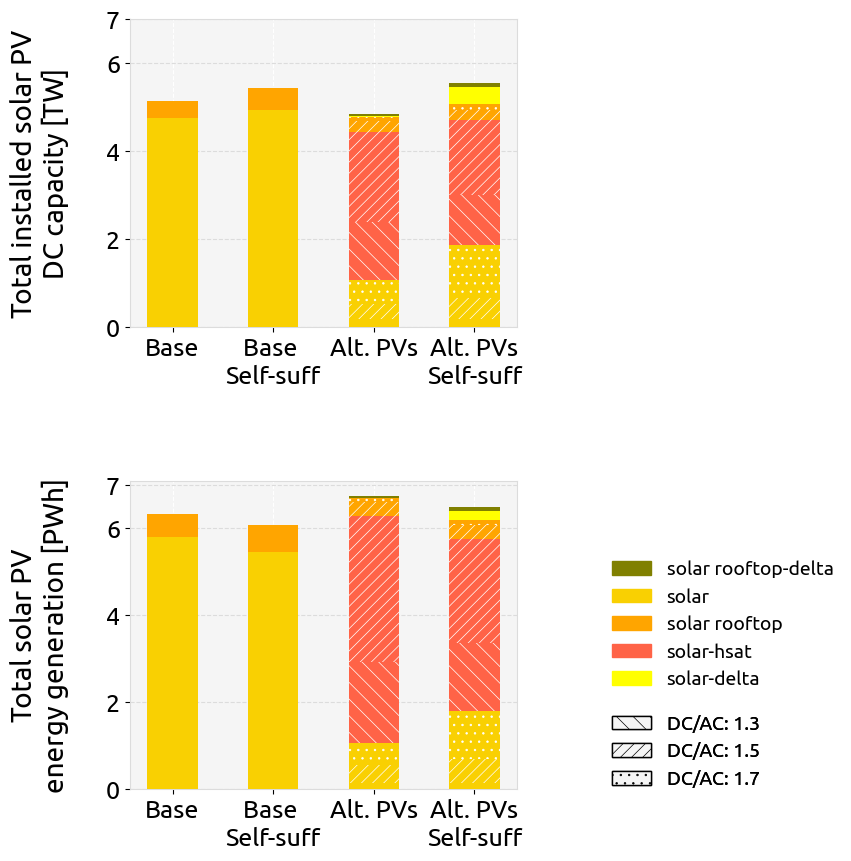

In [14]:

from matplotlib.patches import FancyArrowPatch
import matplotlib.font_manager
import matplotlib.lines as lines

plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['hatch.linewidth'] = 0.5
plt.rcParams['hatch.color'] = 'white'

#plt.rcParams['figure.dpi'] = 1000

    
fig, axs = plt.subplots(2,1, figsize=(5,10)) #, sharey=True)
fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.8)

bar_width=0.5
index=np.arange(4) 

hatches={'inv-1.3':'\\\\', 'inv-1.5':'///', 'inv-1.7':'..','inv-1.9' : '...', } #'+', 'x', 'o', 'O', '.', '*']


base_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'Base']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'Base w Equity']  ,

}


results_generation=pd.DataFrame({})
for scen in base_scen.keys():
  for  year in [2050] : #base_scen[scen][0]:
    scenario=scen.format(str(year))
    n=pypsa.Network(scenario)
    results_generation.loc[ scenario, 'solar']=n.generators_t.p.loc[:, n.generators.carrier=='solar'].sum().sum()*2
    results_generation.loc[ scenario, 'solar rooftop']=n.generators_t.p.loc[:, n.generators.carrier=='solar rooftop'].sum().sum()*2


    
    
k=0
for i,base in enumerate(base_scen.keys()):
            idx1=['solar','solar rooftop'] #[i for i in results_total.index if 'solar' in i and 'thermal' not in i]
            idx2= [base.format(str(2050)) ]
            bottom=0
            bottom_ =0
            axs[0].grid(axis = 'y',color='gainsboro', zorder=0)
            for color, component in enumerate(results_total.loc[idx1, idx2].sum(axis=1).index):
                  axs[0].bar(index[k], results_total.loc[idx1, idx2].sum(axis=1)[component]/1e6
                           , bar_width, bottom=bottom,
                           color=tech_colors[component], zorder=3, )
                  bottom+=results_total.loc[idx1, idx2].sum(axis=1)[component]/1e6
                
                  axs[1].bar(index[k], results_generation.loc[idx2].sum()[component]/1e9 ##Pwh
                           , bar_width, bottom=bottom_,
                           color=tech_colors[component], zorder=3, 
                            )
                  bottom_+=results_generation.loc[idx2].sum()[component]/1e9
                
            k+=1    

tech_names={'solar'                  : 'solar',
'solar-hsat'                :       'solar-hsat',
'solar rooftop'                :    'solar rooftop',
'solar-delta'                   :      'solar-delta',
'solar-inv-1.5'                   :        'solar',
'solar-inv-1.7'                   :        'solar',
'solar-hsat-inv-1.3'              :   'solar-hsat',
'solar-hsat-inv-1.5'              :   'solar-hsat',
'solar rooftop-inv-1.5'           :    'solar rooftop',
'solar rooftop-inv-1.7'           :    'solar rooftop',
'solar rooftop-delta' :    'solar rooftop-delta' ,}

new_solar_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'New-Solar']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2035,2040,2045,2050],'New-Solar w Eqiuty']  ,

}

for i,base in enumerate(new_solar_scen.keys()):
            idx2= [base.format(str(2050))] # for year in new_solar_scen[base][0]]
            bottom=0
            bottom_=0
            axs[1].grid(axis = 'y',color='gainsboro', zorder=0)
            for color, component in enumerate(results_total_new.loc[idx2].sum(axis=0).index):
                 hatch=hatches[component[component.find('inv-'):]] if 'inv' in component else ' '
                 axs[0].bar(index[k], results_total_new.loc[idx2].sum(axis=0)[component]/1e6
                           , bar_width, bottom=bottom,
                             color=tech_colors[tech_names[component]], 
                             zorder=3,
                             hatch=hatch ,
                               )
                 bottom+=results_total_new.loc[idx2].sum(axis=0)[component]/1e6 
                    
                 axs[1].bar(index[k], results_generation_new.loc[idx2].sum()[component]/1e9 ##Pwh
                           , bar_width, bottom=bottom_,
                           color=tech_colors[tech_names[component]], zorder=3, 
                           hatch=hatch)
                 bottom_+=results_generation_new.loc[idx2].sum()[component]/1e9
            k+=1    


    
xlabels = ["Base","Base \nSelf-suff","Alt. PVs", "Alt. PVs\nSelf-suff"]
            #axs[0][i].set_xlabel("", rotation=0)
    
for ax in axs.reshape(-1):

   ax.set_xticks((index))    
   ax.set_xticklabels(xlabels,fontsize=18, rotation=0,ha='center', rotation_mode='anchor')
   ax.tick_params(axis='y', labelsize=18)
            #axs[0][i][i].set_yticks(np.arange(0, 401, 100),fontsize=25) 

axs[0].set_ylabel('Total installed solar PV\nDC capacity [TW]\n',fontsize=20, fontname = 'Ubuntu')
axs[1].set_ylabel('Total solar PV\nenergy generation [PWh]\n',fontsize=20, fontname = 'Ubuntu')

axs[0].set_yticks([0,2, 4, 6, 7],fontsize=20)
axs[1].set_yticks([0,2,4,6,7],fontsize=20)


legend_manual=[]
for key in (set(tech_names.values())):
    legend_manual.append(mpatches.Patch(color=tech_colors[key], label=key))
legend1=plt.legend(handles=legend_manual[::-1],loc='upper left', bbox_to_anchor=(1.2, 0.8),ncol=1,
           fontsize=14,frameon=False)
plt.gca().add_artist(legend1)
solar genera
legend_manual=[]
for i, label in enumerate(['1.3','1.5','1.7']):
    legend_manual.append(mpatches.Patch(facecolor='whitesmoke', hatch=hatches['inv-'+label], edgecolor='k', 
                                        label='DC/AC: '+label))
legend2=plt.legend(handles=legend_manual,loc='upper left', 
                   bbox_to_anchor=(1.2, 0.3),ncol=1,
           fontsize=14,frameon=False)
plt.gca().add_artist(legend2)


## Supplemmntary Figure 11

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


0.5584444557744109


INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


0.6523717998148816


Text(0, 0.5, '1.7° Transition W.\n Alt. solar configs. W.\n Self-sufficency tagret\n\nEnergy Production[TWh]\n')

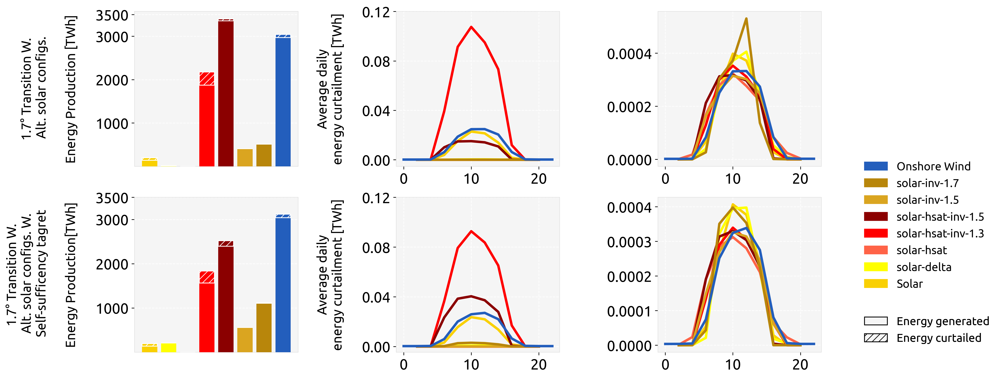

In [5]:
#plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})
plt.rcParams['hatch.linewidth'] = 0.8#
plt.rcParams['figure.dpi'] = 300
plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['axes.linewidth'] = 0.5

fig, axs = plt.subplots(2,3, figsize=(15,7.5)) #, sharey=True)
fig.subplots_adjust(hspace=0.2)
fig.subplots_adjust(wspace=0.6)

bar_width=0.4

hatches={'inv-1.3':'\\', 'inv-1.5':'///', 'inv-1.7':'*','inv-1.9' : '..', } #'+', 'x', 'o', 'O', '.', '*']

base_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2040,2050],'New-Solar']  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_{}.nc':[[2025,2030,2040,2050],'New-Solar w Eqiuty']  ,

}

for s, scen in enumerate(base_scen.keys()):
  for  year in [2050] : #base_scen[scen][0]:
    scenario=scen.format(str(year))
    n=pypsa.Network(scenario)
    
    axs[s,0].grid(axis = 'y', zorder=0)   

    df_supply=n.statistics.supply(comps=["Generator"], aggregate_time='sum').loc['Generator']
    df_curtail=n.statistics.curtailment(comps=["Generator"], aggregate_time='sum').loc['Generator']
    df_curtail_t=n.statistics.curtailment(comps=["Generator"], aggregate_time=False).loc['Generator']
    solar_techs=[i for i in df_supply.index if 'olar' in i and 'thermal' not in i and 'rooftop' not in i]
    solar_techs.append('Onshore Wind')
    index=np.arange(len(solar_techs))

    for i,tech in enumerate(solar_techs):
       axs[s,0].bar(index[i], df_supply.loc[tech]/1e6, color=tech_colors[tech], #TWH
           label=tech, zorder=3)
       axs[s,0].bar(index[i], df_curtail.loc[tech]/1e6, color=tech_colors[tech], bottom= df_supply.loc[tech]/1e6
                    , hatch='///', edgecolor='white' ,
           label=tech, zorder=3)
        
       df_temp= pd.DataFrame(df_curtail_t.loc[tech].T)
       df_temp['hour']=df_temp.index.hour
       axs[s,1].plot(df_temp['hour'][0:12],df_temp.groupby(['hour']).mean().squeeze()/1e6, color=tech_colors[tech],
           label=tech, lw=3) 
        
       axs[s,2].plot(df_temp['hour'][0:12],df_temp.groupby(['hour']).mean().squeeze()/df_curtail.loc[tech], 
                     color=tech_colors[tech],
           label=tech, lw=3) 
    
    if len(solar_techs) > 2:
            print(df_supply.loc['solar-hsat-inv-1.3']/df_supply.loc['solar-hsat-inv-1.5'])
            
    axs[s,0].set_ylabel('Energy generation [TWh]\n',fontsize=20, fontname = 'Ubuntu')        
    

for ax in axs.flat:
    ax.tick_params(axis='y', labelsize=18)
    ax.tick_params(axis='x', labelsize=18)
    
axs[0,0].set_yticks([1000,2000, 3000, 3500])
axs[1,0].set_yticks([1000,2000, 3000, 3500])
axs[1,0].set_xticks([])
axs[0,0].set_xticks([])
axs[0,1].set_yticks([0,0.04,0.08,0.12])
axs[1,1].set_yticks([0,0.04,0.08,0.12])

legend_manual=[]
for key in (solar_techs):
    legend_manual.append(mpatches.Patch(color=tech_colors[key], label=key))
legend1=plt.legend(handles=legend_manual[::-1],loc='upper left', bbox_to_anchor=(1.2, 1.3),ncol=1,
           fontsize=14,frameon=False)
plt.gca().add_artist(legend1)

hatches=['','///']
legend_manual=[]
for i, label in enumerate(['Energy generated','Energy curtailed']):
    legend_manual.append(mpatches.Patch(facecolor='whitesmoke', hatch=hatches[i], edgecolor='k', 
                                        label=label))
legend2=plt.legend(handles=legend_manual,loc='upper left', 
                   bbox_to_anchor=(1.2, 0.3),ncol=1,
           fontsize=14,frameon=False)
plt.gca().add_artist(legend2)

axs[0,1].set_ylabel('Average daily\nenergy curtailment [TWh]\n',fontsize=16, fontname = 'Ubuntu')
axs[1,1].set_ylabel('Average daily\nenergy curtailment [TWh]\n',
                  fontsize=16, fontname = 'Ubuntu')
axs[0,0].set_ylabel('1.7\xb0 Transition W.\n Alt. solar configs.\n\nEnergy Production [TWh]\n',fontsize=16, fontname = 'Ubuntu')
axs[1,0].set_ylabel('1.7\xb0 Transition W.\n Alt. solar configs. W.\n Self-sufficency tagret\n\nEnergy Production[TWh]\n',
                  fontsize=16, fontname = 'Ubuntu')

# Figure 2

In [15]:
iso2name_gpd={'AT':'Austria',
          'BE':'Belgium',
          'BG':'Bulgaria',
          'CH':'Switzerland',
          'CZ':'Czechia',
          'DE':'Germany',
          'DK':'Denmark',
          'EE':'Estonia',
          'ES':'Spain',
          'FI':'Finland',
          'FR':'France',
          'GB':'United Kingdom',
          'GR':'Greece',
          'HR':'Croatia',
          'HU':'Hungary',
          'IT':'Italy',
          'LT':'Lithuania',
          'LU':'Luxembourg',
          'LV':'Latvia',
          'NO':'Norway',
          'PL':'Poland',
          'PT':'Portugal',
          'RO':'Romania',
          'SE':'Sweden',
          'SI':'Slovenia',
          'SK':'Slovakia',
          'IE':'Ireland',
          'NL':'Netherlands',
          'ME':'Montenegro',
          'AL':'Albania',
          'BA':'Bosnia and Herz.',
          'MK':'North Macedonia',
          'RS':'Serbia',  }



In [ ]:
## Use 1-Hr resolution network
n=pypsa.Network('overnight_runs/prenetworks/elec_s370_37m_lv1.1__Co2L0p05-1H-T-H-I-solar+p2-dist1-highrooftop3-newsolar-allin_2050.nc')


In [17]:
## customised to sho energy DECREASE vs cost DECREASe for easier understanding
## the implementation actually has higher cost and higher energy for higer DC/AC ratios

countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])
df_inverter_c2e= pd.DataFrame({})   ##cost to energy ratios
location = (
        n.buses.location
        if "location" in n.buses.columns
        else pd.Series(n.buses.index, index=n.buses.index)
    )
ggrouper = n.generators.bus.map(location).map(n.buses.country)


for solar_tech in ['solar-inv-1.3','solar-inv-1.5','solar-inv-1.7','solar-inv-1.9']: 
        inv_ratio=float(solar_tech.split('-')[2])

        cost_ratio= ((n.generators.capital_cost.filter(like=solar_tech).groupby(ggrouper).mean()/inv_ratio)/
           n.generators.capital_cost[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].groupby(ggrouper).mean())
        
        #solar_p = n.generators_t.p_max_pu.loc[:,[i for i in n.generators.index if n.generators.carrier[i]=='solar']]
        #solar_p[solar_p>1/inv_ratio]=1/inv_ratio

        #energy_ratio=(solar_p.sum(axis=0).groupby(ggrouper).sum()/
          #n.generators_t.p_max_pu[[i for i in n.generators.index
           # if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum())
        
        energy_ratio=((n.generators_t.p_max_pu.filter(like=solar_tech).sum(axis=0).groupby(ggrouper).sum()/
          n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum()))/inv_ratio
        
        AC_cost_ratio = round((inv_ratio*(1-cost_ratio.mean())/(inv_ratio-1))*100,1)
        df_temp = pd.DataFrame({
                   solar_tech+' cost_ratio AC:'+str(AC_cost_ratio)+'%':(1-cost_ratio.values),
                   solar_tech+' energy_ratio AC'+str(AC_cost_ratio)+'%':(1-energy_ratio.values),
                   }, index=cost_ratio.index)
        df_inverter_c2e= pd.concat( [df_inverter_c2e, df_temp ], axis=1)

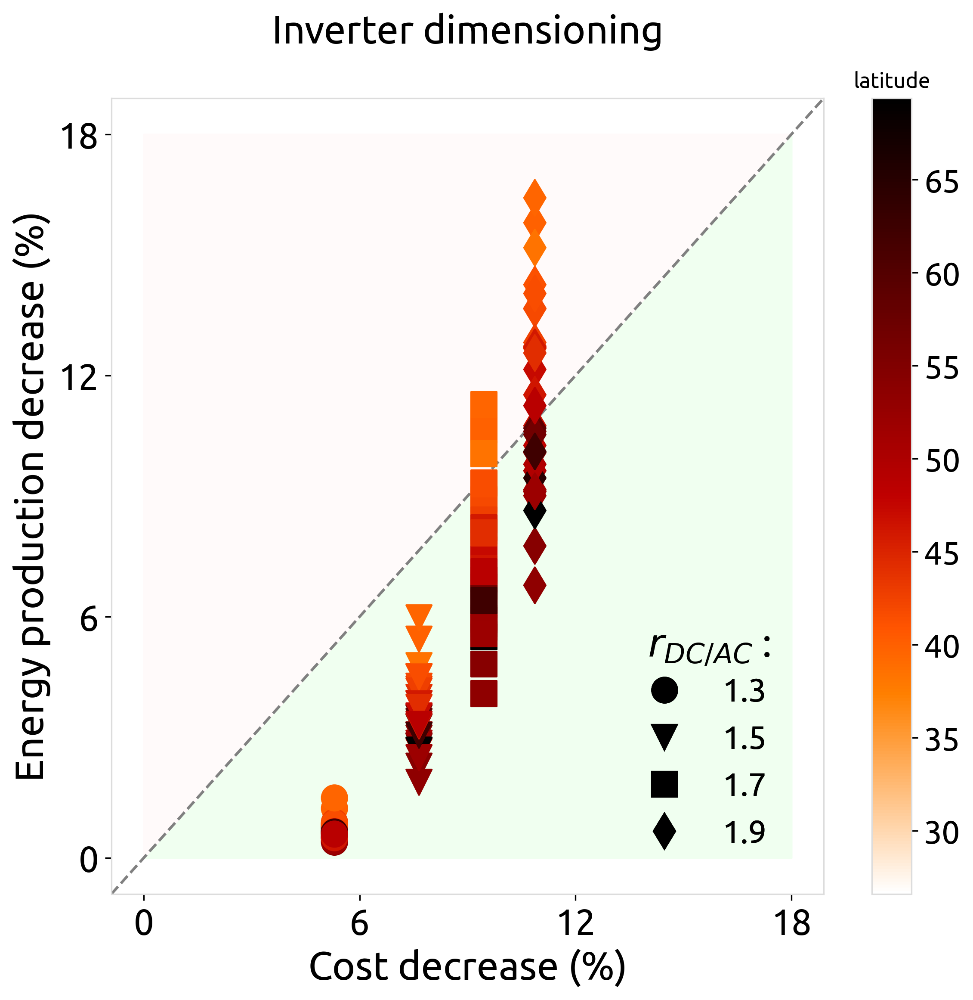

In [21]:
# Figure 2.a

import seaborn as sns
#import matplotlib.markers as mmark
import matplotlib.lines as mlines
# Import Data
import seaborn as sns
import matplotlib.lines as mlines
import geopandas as gpd
from matplotlib import cm, colors


world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])

#df = df_inverter_c2e
#size = df_counts.counts.astype(float)
# Draw Stripplot

markers = {
'solar-inv-1.3': 'o',
'solar-inv-1.5': 'v',
'solar-inv-1.7': 's',
'solar-inv-1.9': 'd', }

label_names = {
'solar-inv-1.3': '1.3',
'solar-inv-1.5': '1.5',
'solar-inv-1.7': '1.7',
'solar-inv-1.9': '1.9', }

SE=['PT','IT','ES','SI','HR','ME','RS','EL','AL','MK','BG','RO','MC']
NE=['DK', 'UK', 'NO','FI','SE','LT','LV','EE','IE', 'GB']
regions={'Southern europe': 'gold', 'Northern Europe' : 'blue', 'Middle Europe': 'green'}
colors= pd.DataFrame(index=df_inverter_c2e.index, columns=['color'])



df_lat=pd.DataFrame(columns=['latitude'])
for country in countries:
    bounds = world.query("name == '{}'".format(iso2name_gpd[country])).iloc[0].geometry.bounds
    df_lat.loc[country]=(bounds[1]+bounds[3])/2  

cmap = plt.get_cmap('gist_heat_r') 
norm = matplotlib.colors.Normalize(vmin=df_lat.min(), vmax=df_lat.max())


for i , country in enumerate(df_inverter_c2e.index)  :  
        colors.loc[country, 'color']=cmap(norm(df_lat.loc[country]))  
        
        """
        if country[:2] in SE:
                colors.loc[country, 'color']= regions['Southern europe']
        elif country[:2] in NE:
                colors.loc[country, 'color']= regions['Northern Europe']

        else :
                colors.loc[country, 'color']= regions['Middle Europe']

        """        

fig, axs = plt.subplots(figsize=(8,8), dpi= 300) 
for i in range(0, len(df_inverter_c2e.columns),2):
 #if '1.3' in  df_inverter_c2e.columns[i] or '1.5' in  df_inverter_c2e.columns[i] or '1.7' in  df_inverter_c2e.columns[i]:

  im= axs.scatter(x=(df_inverter_c2e.iloc[:,i].values*100).round(2), 
                y=(df_inverter_c2e.iloc[:,i+1].values*100).round(2),
              #color=tech_colors[df_inverter_c2e.columns[i].split(' ')[0]],
              marker=markers[df_inverter_c2e.columns[i].split(' ')[0]],
              color=colors['color'], #'none', #
              alpha=1 , 
              #edgecolor=colors['color'],
              #linewidth=2,
                s=200,
             zorder=3,
     )

cbar= fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs, fraction=0.05, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_title('latitude')

#norm = plt.Normalize(df_inverter_c2e.iloc[:,i+1].min()*100, df_inverter_c2e.iloc[:,i+1].max()*100)
#sm = plt.cm.ScalarMappable(cmap="viridis_r", norm=norm)
#sm.set_array([])
#ax.get_legend().remove()
#axs.figure.colorbar(sm)
axs.set_xlabel('Cost decrease (%)',fontsize=22 )
axs.set_ylabel('Energy production decrease (%)',fontsize=22)

# Decorations
plt.title('Inverter dimensioning\n', fontsize=22)
"""
legend_manual=[]
for key in (regions.keys()):
    legend_manual.append(mpatches.Patch(color=regions[key], label=key))
legend2=plt.legend(handles=legend_manual[::-1],loc='upper left', bbox_to_anchor=(1, 1),ncol=1,
           fontsize=18,frameon=False)
plt.gca().add_artist(legend2)

#list_mak = [mmark.MarkerStyle(i) for i in markers.values()]
#list_lab = [i for i in markers.keys()]
"""

legend_manual_2=[]
for key in (markers.keys()):
    legend_manual_2.append(mlines.Line2D([], [], color='k', marker=markers[key], linestyle='None',
                          markersize=14, label=label_names[key])) #key.replace('solar','Solar')))
legend1=plt.legend(handles=legend_manual_2,loc='upper left', bbox_to_anchor=(0.69, 0.31),ncol=1, #55 ,27
           fontsize=18,frameon=False,  )
plt.gca().add_artist(legend1)


lim=18

axs.set_xticks(np.arange(0, 18.1, 6),fontsize=16)
axs.set_yticks(np.arange(0, 18.1, 6),fontsize=16)
axs.tick_params(axis='x', labelsize=20,)
axs.tick_params(axis='y', labelsize=20, )

color=['honeydew','snow']#['honeydew', 'mistyrose']

for i in [1] : #, 0] :
  x1= np.linspace(0, lim, lim-5)
  y2 = x1 * i
  y1 = x1*0 
  axs.fill_between(x1, y1, y2 , color= color[0] , zorder=1 )
   
  x1= np.linspace(0, lim, lim-5) * i
  y2 = x1 * i  
  y1 = x1*0 + lim
  axs.fill_between(x1, y1, y2 , color= color[1] , zorder=1 )

text = '$r_{DC/AC}$ :'
axs.text(14, 5, text, fontsize = 22,  color='black')

axs.axline([0, 0], [12, 12],lw=1.5, color='grey', linestyle='--', zorder=2)
#plt.xlim([0, lim])
#plt.ylim([0, lim])

plt.show()

In [22]:
countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])
df_inverter_c2e= pd.DataFrame({})   ##cost to energy ratios
location = (
        n.buses.location
        if "location" in n.buses.columns
        else pd.Series(n.buses.index, index=n.buses.index)
    )
ggrouper = n.generators.bus.map(location).map(n.buses.country)


solar_tech='solar-hsat'

df_inverter_c2e[solar_tech+' cost_ratio'] = ((n.generators.capital_cost[[i for i in n.generators.index
            if  solar_tech in i and 'inv' not in i]].groupby(ggrouper).mean()/
          n.generators.capital_cost[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].groupby(ggrouper).mean()))-1  


df_inverter_c2e[solar_tech] = ((n.generators_t.p_max_pu[[i for i in n.generators.index
            if  solar_tech in i and 'inv' not in i]].sum(axis=0).groupby(ggrouper).sum()/
          n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum()))-1

for solar_tech in ['solar-hsat-inv-1.3','solar-hsat-inv-1.5','solar-hsat-inv-1.7','solar-hsat-inv-1.9']: 
        inv_ratio=float(solar_tech.split('-')[3])
        cost_ratio=((n.generators.capital_cost.filter(like=solar_tech).groupby(ggrouper).mean()/inv_ratio)/
           n.generators.capital_cost[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].groupby(ggrouper).mean())
         
        ##cost increase
        #solar_p = n.generators_t.p_max_pu.loc[:,[i for i in n.generators.index if n.generators.carrier[i]=='solar-hsat']]
        #solar_p[solar_p>1/inv_ratio]=1/inv_ratio
        
        #energy_ratio=(solar_p.sum(axis=0).groupby(ggrouper).sum()/
         # n.generators_t.p_max_pu[[i for i in n.generators.index
          #  if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum())
        
        energy_ratio=((n.generators_t.p_max_pu.filter(like=solar_tech).sum(axis=0).groupby(ggrouper).sum()/
          n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum()))/inv_ratio
        
        AC_cost_ratio = round((inv_ratio*(1-cost_ratio.mean())/(inv_ratio-1))*100,1)
        df_temp = pd.DataFrame({
                   solar_tech+' cost_ratio AC:'+str(AC_cost_ratio)+'%':(cost_ratio.values-1),
                   solar_tech+' energy_ratio AC'+str(AC_cost_ratio)+'%':(energy_ratio.values-1),
                   }, index=cost_ratio.index)
        df_inverter_c2e= pd.concat( [df_inverter_c2e, df_temp ], axis=1)

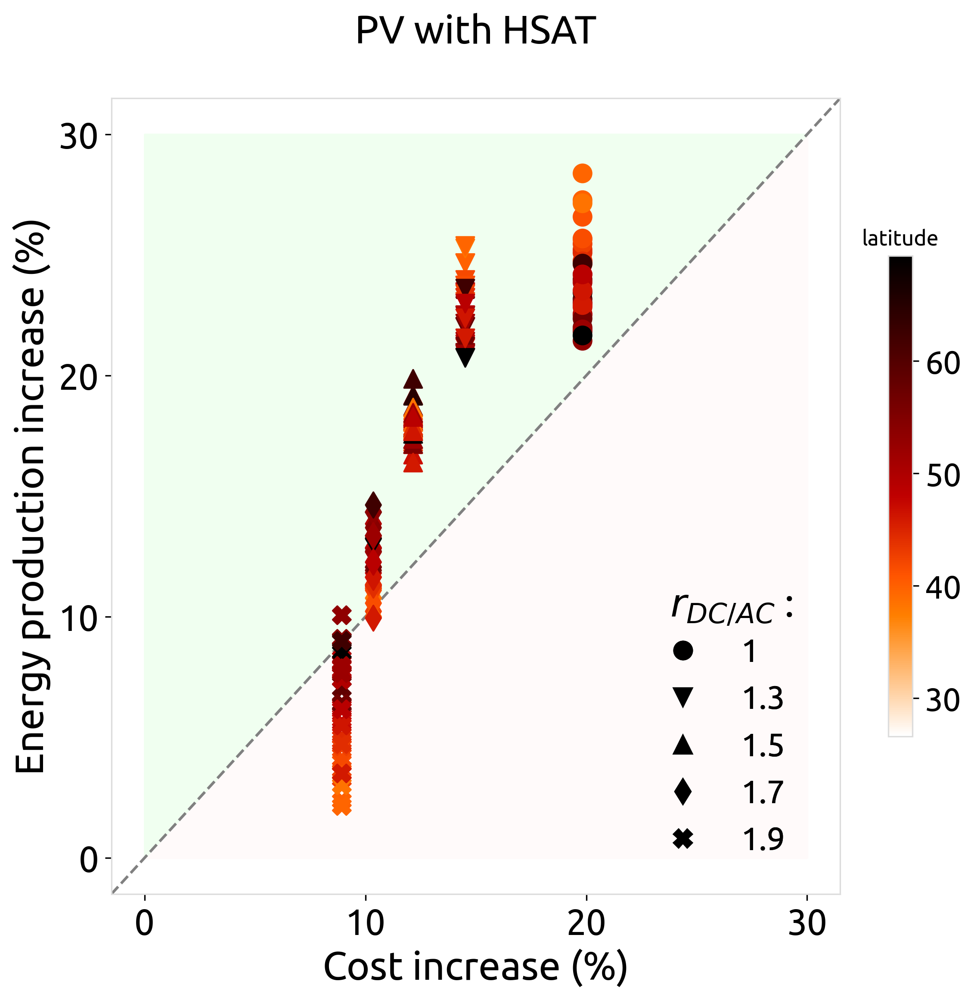

In [23]:
##Figure 2.b
# Import Data
import seaborn as sns
#import matplotlib.markers as mmark
import matplotlib.lines as mlines
# Import Data
import seaborn as sns
import matplotlib.lines as mlines
import geopandas as gpd
from matplotlib import cm, colors


world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])

#df = df_inverter_c2e
#size = df_counts.counts.astype(float)
# Draw Stripplot

markers = {
'solar-hsat' : 'o'    ,
'solar-hsat-inv-1.3': 'v',
'solar-hsat-inv-1.5': '^',
'solar-hsat-inv-1.7': 'd',
'solar-hsat-inv-1.9': 'X', }

label_names = {
'solar-hsat' : '1'    ,
'solar-hsat-inv-1.3': '1.3',
'solar-hsat-inv-1.5': '1.5',
'solar-hsat-inv-1.7': '1.7',
'solar-hsat-inv-1.9': '1.9', }

SE=['PT','IT','ES','SI','HR','ME','RS','EL','AL','MK','BG','RO','MC']
NE=['DK', 'UK', 'NO','FI','SE','LT','LV','EE','IE', 'GB']
regions={'Southern europe': 'gold', 'Northern Europe' : 'blue', 'Middle Europe': 'green'}
colors= pd.DataFrame(index=df_inverter_c2e.index, columns=['color'])



df_lat=pd.DataFrame(columns=['latitude'])
for country in countries:
    bounds = world.query("name == '{}'".format(iso2name_gpd[country])).iloc[0].geometry.bounds
    df_lat.loc[country]=(bounds[1]+bounds[3])/2  

cmap = plt.get_cmap('gist_heat_r') 
norm = matplotlib.colors.Normalize(vmin=df_lat.min(), vmax=df_lat.max())


for i , country in enumerate(df_inverter_c2e.index)  :  
        colors.loc[country, 'color']=cmap(norm(df_lat.loc[country]))  
        
        """
        if country[:2] in SE:
                colors.loc[country, 'color']= regions['Southern europe']
        elif country[:2] in NE:
                colors.loc[country, 'color']= regions['Northern Europe']

        else :
                colors.loc[country, 'color']= regions['Middle Europe']

        """        

fig, axs = plt.subplots(figsize=(8,8), dpi= 300) 
for i in range(0, len(df_inverter_c2e.columns),2):
 #if 'inv' not in   df_inverter_c2e.columns[i]:     
  im= axs.scatter(x=(df_inverter_c2e.iloc[:,i].values*100).round(2), 
                y=(df_inverter_c2e.iloc[:,i+1].values*100).round(2),
              #color=tech_colors[df_inverter_c2e.columns[i].split(' ')[0]],
              marker=markers[df_inverter_c2e.columns[i].split(' ')[0]],
              color=colors['color'], #'none' , 
              alpha=1 , 
              edgecolor=colors['color'],
              #linewidth=2,
              s=100,
              zorder=3,
     )

cbar= fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs, fraction=0.03, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_title('latitude')

#norm = plt.Normalize(df_inverter_c2e.iloc[:,i+1].min()*100, df_inverter_c2e.iloc[:,i+1].max()*100)
#sm = plt.cm.ScalarMappable(cmap="viridis_r", norm=norm)
#sm.set_array([])
#ax.get_legend().remove()
#axs.figure.colorbar(sm)
axs.set_xlabel('Cost increase (%)',fontsize=22 )
axs.set_ylabel('Energy production increase (%)',fontsize=22)

# Decorations
axs.set_title('PV with HSAT\n', fontsize=22)
"""
legend_manual=[]
for key in (regions.keys()):
    legend_manual.append(mpatches.Patch(color=regions[key], label=key))
legend2=plt.legend(handles=legend_manual[::-1],loc='upper left', bbox_to_anchor=(1, 1),ncol=1,
           fontsize=18,frameon=False)
plt.gca().add_artist(legend2)

#list_mak = [mmark.MarkerStyle(i) for i in markers.values()]
#list_lab = [i for i in markers.keys()]
"""
labels={
'solar-hsat' : 'HSAT'    ,
'solar-hsat-inv-1.3': 'HSAT-inv-1.3',
'solar-hsat-inv-1.5': 'HSAT-inv-1.5',
'solar-hsat-inv-1.7': 'HSAT-inv-1.7',
'solar-hsat-inv-1.9': 'HSAT-inv-1.9', }
legend_manual_2=[]
for key in (markers.keys()):
  #if 'inv' not in   key: 
    legend_manual_2.append(mlines.Line2D([], [], color='k', marker=markers[key], linestyle='None',
                          markersize=10, label=label_names[key]))
legend1=plt.legend(handles=legend_manual_2,loc='upper left', bbox_to_anchor=(0.7, 0.36),ncol=1,
           fontsize=18,frameon=False)
plt.gca().add_artist(legend1)


lim=30

axs.set_xticks(np.arange(0, 30.1, 10),fontsize=16)
axs.set_yticks(np.arange(0, 30.1, 10),fontsize=16)
axs.tick_params(axis='x', labelsize=20,)
axs.tick_params(axis='y', labelsize=20,)

text = '$r_{DC/AC}$ :'
axs.text(23.8,10, text, fontsize = 22,  color='black')

color=['honeydew','snow']#['honeydew', 'mistyrose']

for i in [1] : #, 0] :
  x1= np.linspace(0, lim, lim-5)
  y2 = x1 * i
  y1 = x1*0 #+ 5
  axs.fill_between(x1, y1, y2 , color= color[1] , zorder=1 )
   
  x1= np.linspace(0, lim, lim-5) * i
  y2 = x1 * i  
  y1 = x1*0 + lim
  axs.fill_between(x1, y1, y2 , color= color[0] , zorder=1 )


axs.axline([0, 0], [30, 30],lw=1.5, color='grey', linestyle='--', zorder=2)
#plt.xlim([0, lim])
#plt.ylim([0, lim])

plt.show()

In [67]:
# with delta90
n=pypsa.Network('overnight_runs/prenetworks/elec_s370_37m_lv1.1__Co2L0p05-1H-T-H-I-solar+p2-dist1-EQc-highrooftop3-newsolar-test2_2050.nc')


In [25]:
df_inverter_c2e= pd.DataFrame({})   ##cost to energy ratios


ggrouper = n.generators.bus.map(n.buses.country)

countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])
location = (
        n.buses.location
        if "location" in n.buses.columns
        else pd.Series(n.buses.index, index=n.buses.index)
    )
solar_tech='solar-delta'

df_inverter_c2e['solar-delta10 cost_ratio'] =(1-(n.generators.capital_cost[[i for i in n.generators.index
            if  solar_tech in i and '10' in i]].groupby(ggrouper).mean()/
          n.generators.capital_cost[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].groupby(ggrouper).mean()))

df_inverter_c2e['solar-delta10 energy_ratio'] = (1-(n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == solar_tech and '10' in i]].sum(axis=0).groupby(ggrouper).sum()/
          n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum()))


df_inverter_c2e['solar-delta90 cost_ratio'] =(1-(n.generators.capital_cost[[i for i in n.generators.index
            if  solar_tech in i and '90' in i]].groupby(ggrouper).mean()/
          n.generators.capital_cost[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].groupby(ggrouper).mean()))

df_inverter_c2e['solar-delta90 energy_ratio'] = (1-(n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == solar_tech and '90' in i]].sum(axis=0).groupby(ggrouper).sum()/
          n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum()))


df_inverter_c2e['solar-delta cost_ratio'] =(1-(n.generators.capital_cost[[i for i in n.generators.index
            if  solar_tech in i and '10' not in i and '90' not in i]].groupby(ggrouper).mean()/
          n.generators.capital_cost[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].groupby(ggrouper).mean()))

df_inverter_c2e['solar-delta energy_ratio'] = (1-(n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == solar_tech and '10' not in i and '90' not in i]].sum(axis=0).groupby(ggrouper).sum()/
          n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum()))


for solar_tech in ['solar-E', 'solar-SE','solar-SW','solar-W'] :
  for inverter_ratio in ['','1.3','1.5','1.7','1.9']: 

        inv='-inv-'+(inverter_ratio) if inverter_ratio!='' else ''
        
        inv_ratio=float(inverter_ratio) if inverter_ratio!='' else 1
        
        #print(solar_tech+inv)
        cost_ratio=((n.generators.capital_cost[[i for i in n.generators.index if
                             n.generators.carrier[i]== (solar_tech+inv)]].groupby(ggrouper).mean()/inv_ratio)/
           n.generators.capital_cost[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].groupby(ggrouper).mean())
        
        energy_ratio=((n.generators_t.p_max_pu[[i for i in n.generators.index if
                         n.generators.carrier[i]== (solar_tech+inv)]].sum(axis=0).groupby(ggrouper).sum()/
          n.generators_t.p_max_pu[[i for i in n.generators.index
            if n.generators.carrier[i] == 'solar']].sum(axis=0).groupby(ggrouper).sum()))/inv_ratio
        
        df_temp = pd.DataFrame({
                   solar_tech+inv+' cost_ratio':(1-cost_ratio.values),
                   solar_tech+inv+' energy_ratio':(1-energy_ratio.values),
                   }, index=energy_ratio.index)
        df_inverter_c2e= pd.concat( [df_inverter_c2e, df_temp ], axis=1)
        
  
df_inverter_c2e  ##SE has a very small haigher generarion than S due to unsymmetrical solar radiation curve
df_inverter_c2e=df_inverter_c2e.drop(columns=[i for i in df_inverter_c2e.columns if '1.3' in i or '1.7' in i])


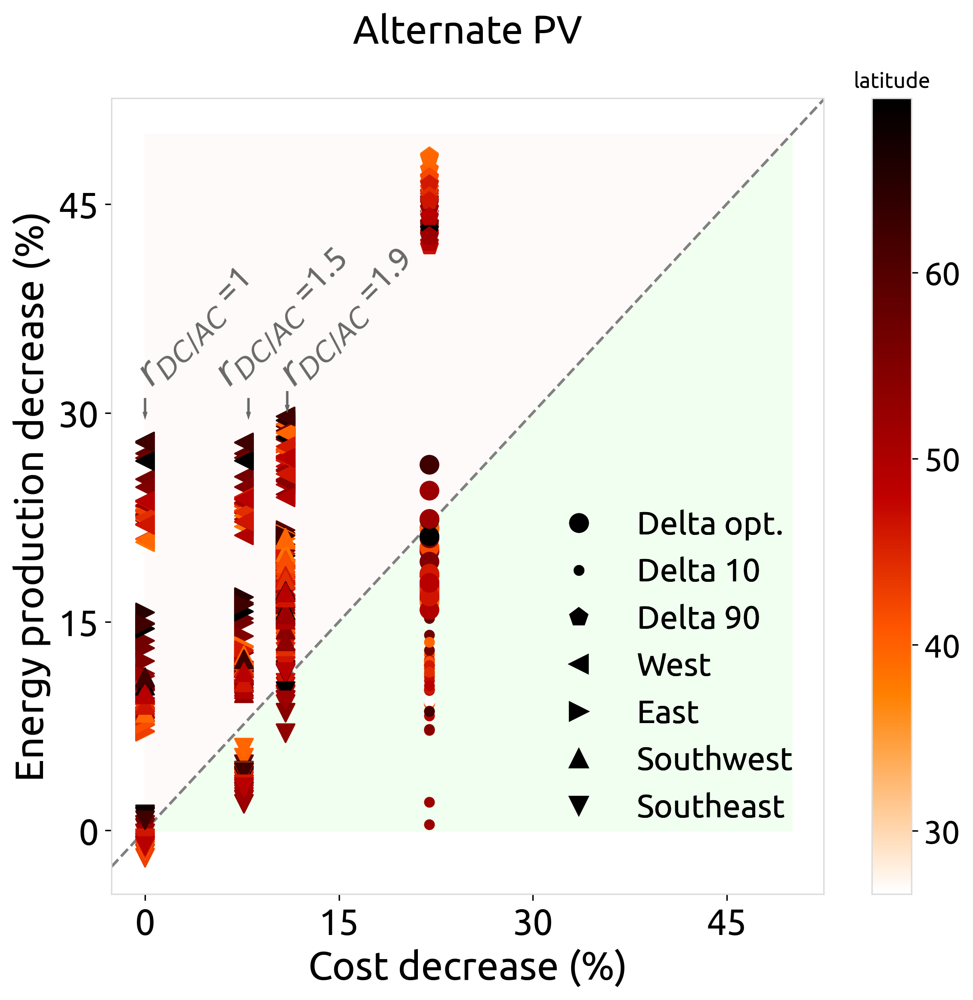

In [37]:
## Figure 2.c
# Import Data
import seaborn as sns
#import matplotlib.markers as mmark
import matplotlib.lines as mlines
# Import Data
import seaborn as sns
import matplotlib.lines as mlines
import geopandas as gpd
from matplotlib import cm, colors


world = gpd.read_file(gpd.datasets.get_path("naturalearth_lowres"))
countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])

#df = df_inverter_c2e
#size = df_counts.counts.astype(float)
# Draw Stripplot

markers = {
'solar-delta':'o', 
'solar-delta10':'.',
'solar-delta90':'p',
'solar-W' : '<'  , #'1',
#'solar-W-inv-1.3': 'h',   
'solar-W-inv-1.5':'<' ,# '2',
#'solar-W-inv-1.7': 'H',
'solar-W-inv-1.9': '<' ,# '3',
'solar-E' : '>' , #'+', #'v'    ,
#'solar-E-inv-1.3': '<',
'solar-E-inv-1.5': '>' , #'<',
#'solar-E-inv-1.7': '^',  
'solar-E-inv-1.9': '>' , #'X',
'solar-SW' : '^'    ,
#'solar-SW-inv-1.3': 'P',
'solar-SW-inv-1.5': '^' , #'<',
#'solar-SW-inv-1.7': 'X',
'solar-SW-inv-1.9': '^' , #'>',
'solar-SE' : 'v',# 'd'    ,
#'solar-SE-inv-1.3': 'D',
'solar-SE-inv-1.5': 'v' , #'D',
#'solar-SE-inv-1.7': 's',  
'solar-SE-inv-1.9': 'v' , #'s',

 }


colors= pd.DataFrame(index=df_inverter_c2e.index, columns=['color'])


df_lat=pd.DataFrame(columns=['latitude'])
for country in countries:
    bounds = world.query("name == '{}'".format(iso2name_gpd[country])).iloc[0].geometry.bounds
    df_lat.loc[country]=(bounds[1]+bounds[3])/2  

cmap = plt.get_cmap('gist_heat_r') 
norm = matplotlib.colors.Normalize(vmin=df_lat.min(), vmax=df_lat.max())
for i , country in enumerate(df_inverter_c2e.index)  :  
        colors.loc[country, 'color']=cmap(norm(df_lat.loc[country]))  
    

fig, axs = plt.subplots(figsize=(8,8), dpi= 300) 
for i in range(0, len(df_inverter_c2e.columns),2):

    im= axs.scatter(x=(df_inverter_c2e.iloc[:,i].values*100).round(2), 
                y=(df_inverter_c2e.iloc[:,i+1].values*100).round(2),
              #color=tech_colors[df_inverter_c2e.columns[i].split(' ')[0]],
              marker=markers[df_inverter_c2e.columns[i].split(' ')[0]],
              color=colors['color'], #'none'
              #alpha=1 , 
              #edgecolor=colors['color'],
              #linewidth=2,  
                s=100,
             zorder=3,
     )

cbar= fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs, fraction=0.05, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_title('latitude')
cbar.set_ticks(np.arange(30, 70, 10)) 

axs.set_xlabel('Cost decrease (%)',fontsize=22 )
axs.set_ylabel('Energy production decrease (%)',fontsize=22)

# Decorations
axs.set_title('Alternate PV\n', fontsize=22)

labels={
'solar-W' : 'West'    ,
#'solar-W-inv-1.5': 'West-1.5',
#'solar-W-inv-1.9': 'West-1.9',
'solar-E' : 'East'    ,  
#'solar-E-inv-1.5': 'East-1.5'    ,
#'solar-E-inv-1.9': 'East-1.9'    ,  
'solar-SW' : 'Southwest'     ,
#'solar-SW-inv-1.5': 'S.W.-1.5'    ,
#'solar-SW-inv-1.9': 'S.W-1.9'    ,
'solar-SE' : 'Southeast'    ,
#'solar-SE-inv-1.5': 'S.E.-1.5'    ,
#'solar-SE-inv-1.9': 'S.E-1.9'    ,
'solar-delta':'Delta opt.', 
'solar-delta10':'Delta 10',
'solar-delta90':'Delta 90'

}
legend_manual_2=[]
for key in (markers.keys()):
   if key in labels: 
    legend_manual_2.append(mlines.Line2D([], [], color='k', marker=markers[key], linestyle='None',
                          markersize=10, label=labels[key]))
legend1=plt.legend(handles=legend_manual_2,loc='upper left', bbox_to_anchor=(0.57, 0.52),ncol=1,
           fontsize=18,frameon=False)
plt.gca().add_artist(legend1)


lim=50

axs.set_xticks(np.arange(0, 50.1, 15),fontsize=16)
axs.set_yticks(np.arange(0, 50.1, 15),fontsize=16)
axs.tick_params(axis='x', labelsize=20, )
axs.tick_params(axis='y', labelsize=20,)


color=['honeydew','snow']#['honeydew', 'mistyrose']

for i in [1] : #, 0] :
  x1= np.linspace(0, lim, lim-5)
  y2 = x1 * i
  y1 = x1*0 + 0
  axs.fill_between(x1, y1, y2 , color= color[0] , zorder=1 )
   
  x1= np.linspace(0, lim, lim-5) * i
  y2 = x1 * i  
  y1 = x1*0 + lim
  axs.fill_between(x1, y1, y2 , color= color[1] , zorder=1 )

axs.axline([0, 0], [25, 25],lw=1.5, color='grey', linestyle='--', zorder=2)
#plt.xlim([0, lim])
#plt.ylim([0, lim])


axs.text(-1, 32, '$r_{DC/AC}$', fontsize = 22, rotation=45, color='dimgrey')
axs.text(5, 38, '=1', fontsize = 18, rotation=45, color='dimgrey')
axs.text(5, 32, '$r_{DC/AC}$', fontsize = 22, rotation=45, color='dimgrey')
axs.text(11, 38, '=1.5', fontsize = 18, rotation=45, color='dimgrey')
axs.text(10, 32, '$r_{DC/AC}$', fontsize = 22, rotation=45, color='dimgrey')
axs.text(16, 38, '=1.9', fontsize = 18, rotation=45, color='dimgrey')
axs.arrow(0, 31, 0, -1, 
          head_width = 0.2, 
          width = 0.05,  color='dimgrey', zorder=3)
axs.arrow(8, 31, 0, -1, 
          head_width = 0.2, 
          width = 0.05,  color='dimgrey', zorder=3)
axs.arrow(11, 31.5, 0, -1, 
          head_width = 0.2, 
          width = 0.05,  color='dimgrey', zorder=3)
plt.show()

## Figure 8 + Supplementary Figure 5

/tmp/ipykernel_14926/1980898660.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_solar_inv[0][df_solar_inv[0]>1/1.9] = 1/1.9
/tmp/ipykernel_14926/1980898660.py:49: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_tracking_inv[0][df_tracking_inv[0]>1/1.9] = 1/1.9


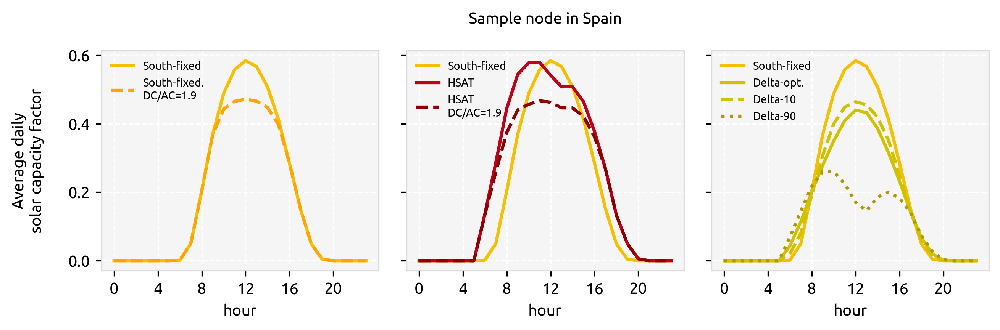

In [61]:
# Figure 8
import datetime
import copy
from matplotlib.dates import DateFormatter
fig, axs = plt.subplots(1,3,figsize=(10,2.5),sharex=True, sharey=True) 
fig.subplots_adjust(wspace=0.1)

plt.rcParams['figure.dpi'] = 300
plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')

colors=['#f5bf03','orange','#be0119','darkred', '#d0c101','gold','#b29705']
fill_colors=['lemonchiffon','mistyrose','thistle']

countries=['ES1 21'] # change to 'IT1 0' for Italy, DE1 0' for germany and 'DK1 0' for denmark
country='ES1 21'



n=pypsa.Network('overnight_runs/prenetworks/elec_s370_37m_lv1.1__Co2L0p05-1H-T-H-I-solar+p2-dist1-EQc-highrooftop3-newsolar-test2_2050.nc')


date_form = DateFormatter("%b %-d")

for i, country in enumerate(countries):
    #1st
    df_solar=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar']].filter(like=country).sum(axis=1))  #GWh 
    df_solar['hour']=df_solar.index.hour
    l_solar,= axs[0].plot(df_solar['hour'][0:24],df_solar.groupby(['hour']).mean()
                          ,color=colors[0],label='solar',lw=2)
    
    df_solar_inv= copy.deepcopy(df_solar)
    df_solar_inv[0][df_solar_inv[0]>1/1.9] = 1/1.9 
    l_inv,= axs[0].plot(df_solar_inv['hour'][0:24],df_solar_inv.groupby(['hour']).mean()
                          ,color=colors[1],label='solar',lw=2, linestyle='--')
    
    ##2nd
    l_solar,= axs[1].plot(df_solar['hour'][0:24],df_solar.groupby(['hour']).mean()
                          ,color=colors[0],label='solar',lw=2)
        
    df_tracking=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar-hsat']].filter(like=country).sum(axis=1))  #GWh 
    df_tracking['hour']=df_tracking.index.hour
    l_tracking,= axs[1].plot(df_tracking['hour'][0:24],df_tracking.groupby(['hour']).mean(),
                             color=colors[2],label='solar',lw=2,)
    
    df_tracking_inv= copy.deepcopy(df_tracking)
    df_tracking_inv[0][df_tracking_inv[0]>1/1.9] = 1/1.9 
    l_inv_tracking,= axs[1].plot(df_tracking_inv['hour'][0:24],df_tracking_inv.groupby(['hour']).mean()
                          ,color=colors[3],label='solar',lw=2, linestyle='--')
    
    ###3rd
    l_solar,= axs[2].plot(df_solar['hour'][0:24],df_solar.groupby(['hour']).mean()
                          ,color=colors[0],label='solar',lw=2)
        
    df_delta=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                             'solar-delta' in i and '90' not in i and '10' not in i]].filter(like=country).sum(axis=1))  #GWh 
    df_delta['hour']=df_delta.index.hour
    l_delta,= axs[2].plot(df_solar['hour'][0:24],df_delta.groupby(['hour']).mean(),
                          color=colors[4],label='solar',lw=2,)
    
    df_delta_10=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              'solar-delta' in i and '10' in i]].filter(like=country).sum(axis=1))  #GWh 
    df_delta_10['hour']=df_delta_10.index.hour
    df_delta_10,= axs[2].plot(df_solar['hour'][0:24],df_delta_10.groupby(['hour']).mean(),
                          color=colors[4],label='solar',lw=2, linestyle='--')
    
    df_delta_60=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar-delta' and '90' in i]].filter(like=country).sum(axis=1))  #GWh 
    df_delta_60['hour']=df_delta_60.index.hour
    
    l_delta_60,= axs[2].plot(df_solar['hour'][0:24],df_delta_60.groupby(['hour']).mean(),
                          color=colors[6],label='solar',lw=2, linestyle='dotted')
    
    #axs.fill_between(df_solar['hour'][0:24],(df_delta.groupby(['hour']).mean()-df_delta.groupby(['hour']).std()).squeeze(),
    #             (df_delta.groupby(['hour']).mean()+df_delta.groupby(['hour']).std()).squeeze(),
    #                    facecolor=fill_colors[2], alpha=0.2)
    
    #r_delta = axs.fill(np.NaN, np.NaN, fill_colors[2], alpha=0.2)

    
for ax in axs.flat:
    ax.tick_params(axis='y', labelsize=10)
    ax.set_yticks(np.arange(0, 0.61, 0.2),fontsize=10)   
    ax.set_xticks(np.arange(0, 24, 4),fontsize=10)   
    #'if i==1 :  axs.legend([l_solar, (l_dist, r_dist)], ["solar (mean+range)", "HV to LV evergy\nflow (mean+range)"], loc=2)
                  
    #fig.autofmt_xdate()
    ax.set_xlabel("hour",fontsize=10)

axs[0].set_ylabel('Average daily\nsolar capacity factor\n',fontsize=10,
                  fontname = 'Ubuntu')
axs[1].set_title('Sample node in Spain\n',fontsize=10,
                  fontname = 'Ubuntu')#,labelpad=10)

axs[0].legend([(l_solar),(l_inv),],
           ["South-fixed","South-fixed.\nDC/AC=1.9",], 
           loc='upper left', ncol=1,
          fontsize=7, frameon=False)
axs[1].legend([(l_solar),(l_tracking),(l_inv_tracking),],
           ["South-fixed","HSAT","HSAT\nDC/AC=1.9"], 
           loc='upper left',ncol=1,
          fontsize=7, frameon=False)
axs[2].legend([(l_solar),(l_delta), (df_delta_10) , (l_delta_60)],
           ["South-fixed","Delta-opt.", "Delta-10","Delta-90"], 
           loc='upper left',ncol=1,
          fontsize=7, frameon=False)
#plt.legend(loc='center right', bbox_to_anchor=(1.4, 0.5),ncol=1,
 #         fontsize=12, frameon=False) 

## Supplementary figure 7

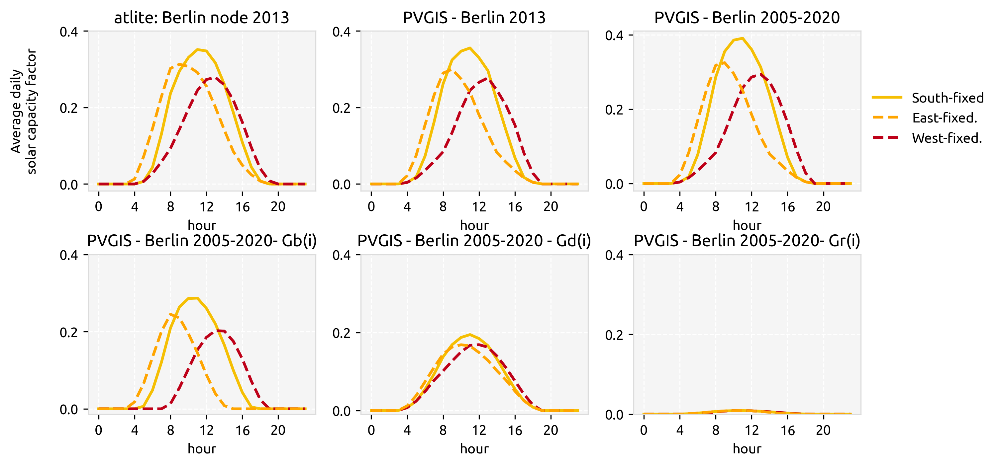

In [72]:
import datetime
import copy
from matplotlib.dates import DateFormatter
fig, axs = plt.subplots(2,3 ,figsize=(10,5),sharex=False, sharey=False) 
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(hspace=0.4)
plt.rcParams['axes.facecolor'] = 'whitesmoke'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})

plt.rcParams['figure.dpi'] = 1000
plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')

colors=['#f5bf03','orange','#be0119','darkred', '#d0c101','gold','#b29705']
fill_colors=['lemonchiffon','mistyrose','thistle']

n=pypsa.Network('resources/networks/elec_s370_37m_ec_lv1.1_.nc')

countries=['DE1 8']# , 'IT1 0', 'DE1 0', 'DK1 0'] # 'ES', ' ']


index=np.arange(4)

date_form = DateFormatter("%b %-d")

for i, country in enumerate(countries):
    #1st
    df_solar=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar']].filter(like=country).sum(axis=1))  #GWh 
    df_solar['hour']=df_solar.index.hour
    l_solar,= axs[0,0].plot(df_solar['hour'][0:24],df_solar.groupby(['hour']).mean()
                          ,color=colors[0],label='solar',lw=2)
    
    df_solar_E=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar-E']].filter(like=country).sum(axis=1))     
    df_solar_E['hour']=df_solar_E.index.hour
    l_solar_E,= axs[0,0].plot(df_solar_E['hour'][0:24],df_solar_E.groupby(['hour']).mean()
                          ,color=colors[1],label='solar',lw=2, linestyle='--')
    
    ##2nd
    df_solar_W=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar-W']].filter(like=country).sum(axis=1))    
    df_solar_W['hour']=df_solar_W.index.hour
    l_solar_W,= axs[0,0].plot(df_solar_W['hour'][0:24],df_solar_W.groupby(['hour']).mean()
                          ,color=colors[2],label='solar',lw=2, linestyle='--')
    
## PVGIS


PVGIS=pd.read_csv('data/PVGIS_berlin_15_years.csv', index_col=0)
PVGIS= PVGIS.set_index(pd.to_datetime(PVGIS.index, format='%Y%m%d:%H%M'))
df_dist=PVGIS
df_dist['hour']=df_dist.index.hour

axs[0,1].plot(df_dist['hour'][0:24],df_dist['2013-01-01 00:10:00':'2013-12-31 23:10:00'].P_south.groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[0,1].plot(df_dist['hour'][0:24],df_dist['2013-01-01 00:10:00':'2013-12-31 23:10:00'].P_west.groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[0,1].plot(df_dist['hour'][0:24],df_dist['2013-01-01 00:10:00':'2013-12-31 23:10:00'].P_east.groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[0,1].set_title('PVGIS - Berlin 2013')

axs[0,2].plot(df_dist['hour'][0:24],df_dist.P_south.groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[0,2].plot(df_dist['hour'][0:24],df_dist.P_west.groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[0,2].plot(df_dist['hour'][0:24],df_dist.P_east.groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[0,2].set_title('PVGIS - Berlin 2005-2020')

##radiation components
axs[1,0].plot(df_dist['hour'][0:24],df_dist['Gb(i)_south'].groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[1,0].plot(df_dist['hour'][0:24],df_dist['Gb(i)_west'].groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[1,0].plot(df_dist['hour'][0:24],df_dist['Gb(i)_east'].groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[1,0].set_title('PVGIS - Berlin 2005-2020- Gb(i)')  ##beam(direct)

##radiation components
axs[1,1].plot(df_dist['hour'][0:24],df_dist['Gd(i)_south'].groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[1,1].plot(df_dist['hour'][0:24],df_dist['Gd(i)_west'].groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[1,1].plot(df_dist['hour'][0:24],df_dist['Gd(i)_east'].groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[1,1].set_title('PVGIS - Berlin 2005-2020 - Gd(i)')  ##diffuse

##radiation components
axs[1,2].plot(df_dist['hour'][0:24],df_dist['Gr(i)_south'].groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[1,2].plot(df_dist['hour'][0:24],df_dist['Gr(i)_west'].groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[1,2].plot(df_dist['hour'][0:24],df_dist['Gr(i)_east'].groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[1,2].set_title('PVGIS - Berlin 2005-2020- Gr(i)') ##re


    
for ax in axs.flat:
    ax.tick_params(axis='y', labelsize=10)
    ax.set_yticks(np.arange(0, 0.41, 0.2),fontsize=10)   
    ax.set_xticks(np.arange(0, 24, 4),fontsize=10)   
    #'if i==1 :  axs.legend([l_solar, (l_dist, r_dist)], ["solar (mean+range)", "HV to LV evergy\nflow (mean+range)"], loc=2)
                  
    #fig.autofmt_xdate()
    ax.set_xlabel("hour",fontsize=10)

#axs[1,2].set_xticks((index))    
#axs[1,2].set_xticklabels(["South-fixed","Delta-35", "Delta-10","Delta-60"],
#                         fontsize=10, rotation=30,ha='right', rotation_mode='anchor')


axs[0,0].set_ylabel('Average daily\nsolar capacity factor\n',fontsize=10,
                  fontname = 'Ubuntu') 
axs[0,0].set_title('atlite: Berlin node 2013',fontsize=12,
                  fontname = 'Ubuntu')#,labelpad=10)
#axs[1,0].set_ylabel('Total annual\ngeneration [MWh/MW_p]\n',fontsize=10,
#                  fontname = 'Ubuntu')

axs[0,2].legend([(l_solar),(l_solar_E),(l_solar_W)],
           ["South-fixed","East-fixed.","West-fixed."], 
           loc='upper left', ncol=1,
          fontsize=10, frameon=False,
             bbox_to_anchor=(1, 0.7))


In [ ]:
# Figures supp.
import datetime
import copy
from matplotlib.dates import DateFormatter
fig, axs = plt.subplots(2,3 ,figsize=(10,5),sharex=False, sharey=False) 
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(hspace=0.4)
plt.rcParams['axes.facecolor'] = 'whitesmoke'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})

plt.rcParams['figure.dpi'] = 300
plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')

colors=['#f5bf03','orange','#be0119','darkred', '#d0c101','gold','#b29705']
fill_colors=['lemonchiffon','mistyrose','thistle']

countries=['FR1 30']# , 'IT1 0', 'DE1 0', 'DK1 0'] # 'ES', ' ']


index=np.arange(4)

date_form = DateFormatter("%b %-d")

for i, country in enumerate(countries):
    #1st
    df_solar=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar']].filter(like=country).sum(axis=1))  #GWh 
    df_solar['hour']=df_solar.index.hour
    l_solar,= axs[0,0].plot(df_solar['hour'][0:24],df_solar.groupby(['hour']).mean()
                          ,color=colors[0],label='solar',lw=2)
    
    df_solar_E=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar-E']].filter(like=country).sum(axis=1))     
    df_solar_E['hour']=df_solar_E.index.hour
    l_solar_E,= axs[0,0].plot(df_solar_E['hour'][0:24],df_solar_E.groupby(['hour']).mean()
                          ,color=colors[1],label='solar',lw=2, linestyle='--')
    
    ##2nd
    df_solar_W=pd.DataFrame(n.generators_t.p_max_pu[[i for i in n.generators.index if 
                                              n.generators.carrier[i]=='solar-W']].filter(like=country).sum(axis=1))    
    df_solar_W['hour']=df_solar_W.index.hour
    l_solar_W,= axs[0,0].plot(df_solar_W['hour'][0:24],df_solar_W.groupby(['hour']).mean()
                          ,color=colors[2],label='solar',lw=2, linestyle='--')
    
## PVGIS


PVGIS=pd.read_csv('data/PVGIS_paris_15_years.csv', index_col=0)
PVGIS= PVGIS.set_index(pd.to_datetime(PVGIS.index, format='%Y%m%d:%H%M'))
df_dist=PVGIS
df_dist['hour']=df_dist.index.hour

axs[0,1].plot(df_dist['hour'][0:24],df_dist['2013-01-01 00:10:00':'2013-12-31 23:10:00'].P_south.groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[0,1].plot(df_dist['hour'][0:24],df_dist['2013-01-01 00:10:00':'2013-12-31 23:10:00'].P_west.groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[0,1].plot(df_dist['hour'][0:24],df_dist['2013-01-01 00:10:00':'2013-12-31 23:10:00'].P_east.groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[0,1].set_title('PVGIS - Paris 2013')

axs[0,2].plot(df_dist['hour'][0:24],df_dist.P_south.groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[0,2].plot(df_dist['hour'][0:24],df_dist.P_west.groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[0,2].plot(df_dist['hour'][0:24],df_dist.P_east.groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[0,2].set_title('PVGIS - Paris 2005-2020')

##radiation components
axs[1,0].plot(df_dist['hour'][0:24],df_dist['Gb(i)_south'].groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[1,0].plot(df_dist['hour'][0:24],df_dist['Gb(i)_west'].groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[1,0].plot(df_dist['hour'][0:24],df_dist['Gb(i)_east'].groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[1,0].set_title('PVGIS - Paris 2005-2020- Gb(i)')  ##beam(direct)

##radiation components
axs[1,1].plot(df_dist['hour'][0:24],df_dist['Gd(i)_south'].groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[1,1].plot(df_dist['hour'][0:24],df_dist['Gd(i)_west'].groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[1,1].plot(df_dist['hour'][0:24],df_dist['Gd(i)_east'].groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[1,1].set_title('PVGIS - Paris 2005-2020 - Gd(i)')  ##diffuse

##radiation components
axs[1,2].plot(df_dist['hour'][0:24],df_dist['Gr(i)_south'].groupby(df_dist['hour']).mean()/1e3, label='south', color=colors[0],
           lw=2, )
axs[1,2].plot(df_dist['hour'][0:24],df_dist['Gr(i)_west'].groupby(df_dist['hour']).mean()/1e3, label='west', color=colors[2],
           lw=2, linestyle='--')
axs[1,2].plot(df_dist['hour'][0:24],df_dist['Gr(i)_east'].groupby(df_dist['hour']).mean()/1e3, label='east', color=colors[1],
           lw=2, linestyle='--')
axs[1,2].set_title('PVGIS - Paris 2005-2020- Gr(i)') ##re


    
for ax in axs.flat:
    ax.tick_params(axis='y', labelsize=10)
    ax.set_yticks(np.arange(0, 0.41, 0.2),fontsize=10)   
    ax.set_xticks(np.arange(0, 24, 4),fontsize=10)   
    #'if i==1 :  axs.legend([l_solar, (l_dist, r_dist)], ["solar (mean+range)", "HV to LV evergy\nflow (mean+range)"], loc=2)
                  
    #fig.autofmt_xdate()
    ax.set_xlabel("hour",fontsize=10)

#axs[1,2].set_xticks((index))    
#axs[1,2].set_xticklabels(["South-fixed","Delta-35", "Delta-10","Delta-60"],
#                         fontsize=10, rotation=30,ha='right', rotation_mode='anchor')


axs[0,0].set_ylabel('Average daily\nsolar capacity factor\n',fontsize=10,
                  fontname = 'Ubuntu') 
axs[0,0].set_title('atlite: Paris node 2013',fontsize=12,
                  fontname = 'Ubuntu')#,labelpad=10)
#axs[1,0].set_ylabel('Total annual\ngeneration [MWh/MW_p]\n',fontsize=10,
#                  fontname = 'Ubuntu')

axs[0,2].legend([(l_solar),(l_solar_E),(l_solar_W)],
           ["South-fixed","East-fixed.","West-fixed."], 
           loc='upper left', ncol=1,
          fontsize=10, frameon=False,
             bbox_to_anchor=(1, 0.7))


# Supplementary figure 4

In [37]:
import pypsa
n=pypsa.Network('overnight_runs/prenetworks/elec_s370_37m_lv1.1__Co2L0p05-1H-T-H-I-solar+p2-dist1-highrooftop3-newsolar-allin_2050.nc')

In [19]:
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : False, "grid.color" :"gainsboro" , "grid.linestyle":"dashed"})

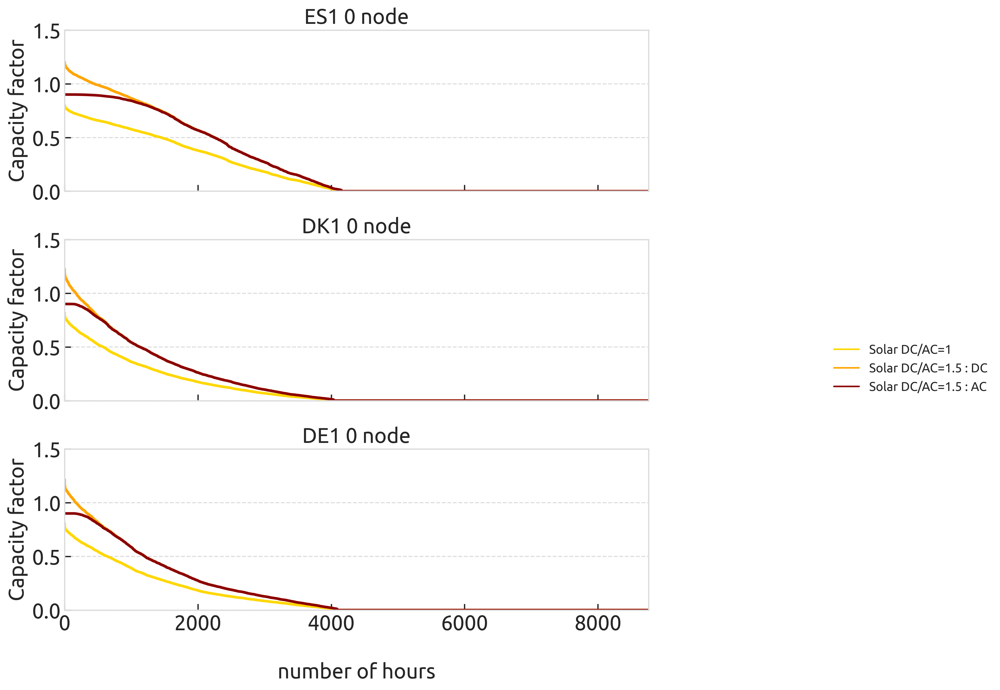

In [59]:
## solaar and solar with inverter duration curve


import matplotlib.ticker as mticker
from matplotlib.lines import Line2D
import copy

inverter_ratio=1.5

countries=['ES1 0','DK1 0','DE1 0']

fig, axs = plt.subplots(len(countries), 1, figsize=(10,10),sharex=True, sharey=True)  #5, 1, 
plt.rcParams['figure.dpi'] = 300
fig.subplots_adjust(hspace=0.3)

#      index=np.arange(len(results.columns))
style=['-','--']
for i in range(1):
   for j,country in enumerate(countries): 
     axs[j].grid(axis = 'y', zorder=0)   
     df = (n.generators_t.p_max_pu[[i for i in n.generators.index if   ##this is equal for n1 or n2
                                              n.generators.carrier[i]=='solar']].filter(like=country).sum(axis=1))  #GWh
     to_plot = df.sort_values(ascending=False).reset_index(drop=True)
     to_plot.index = [k / len(df) * 8760 for k in to_plot.index]
     axs[j].plot(to_plot,color='gold',linestyle=style[0], linewidth=2.5)
     #axs.set_facecolor("whitesmoke")

    
     df = df * 1.5
     to_plot = df.sort_values(ascending=False).reset_index(drop=True)
     to_plot.index = [k / len(df) * 8760 for k in to_plot.index]
     axs[j].plot(to_plot,color='orange',linestyle=style[0], linewidth=2.5)
     axs[j].set_title(country+' node', fontsize=12)
     #axs.set_facecolor("whitesmoke")
    

     df = (n.generators_t.p_max_pu.filter(like='solar-inv-1.5').filter(like=country).sum(axis=1))
     to_plot = df.sort_values(ascending=False).reset_index(drop=True)
     to_plot.index = [k / len(df) * 8760 for k in to_plot.index]
     axs[j].plot(to_plot,color='darkred',linestyle=style[0], linewidth=2.5)
     axs[j].set_title(country+' node', fontsize=20)   
        
     axs[j].axvline(0, linewidth=0.5, linestyle=":", color="grey")
     axs[j].axvline(8760, linewidth=0.5, linestyle=":", color="grey")
     axs[j].axhline(0, linewidth=0.5, linestyle=":", color="grey")
     axs[j].set_ylabel(ylabel="Capacity factor", fontsize=20) 
     axs[i].set_yticks(np.arange(0, 1.6, .5))
     plt.xlim(0,8760)
     axs[i].set_xticks(np.arange(0, 8001, 2000))
     plt.ylim(0,1.5)

axs[2].set_xlabel(xlabel='\nnumber of hours', fontsize=20)  


legend_manual=[]
labels=['Solar DC/AC=1','Solar DC/AC=1.5 : DC', 'Solar DC/AC=1.5 : AC']

custom_lines = [Line2D([0], [0], color='gold', linestyle=style[0]),
                Line2D([0], [0], color='orange', linestyle=style[0]),
                Line2D([0], [0], color='darkred',linestyle=style[0])]

plt.legend(custom_lines, labels,loc='center right', bbox_to_anchor=(1.6, 1.5),ncol=1,
           fontsize=12, frameon=False) 



#axs.xaxis.set_major_locator(1000)


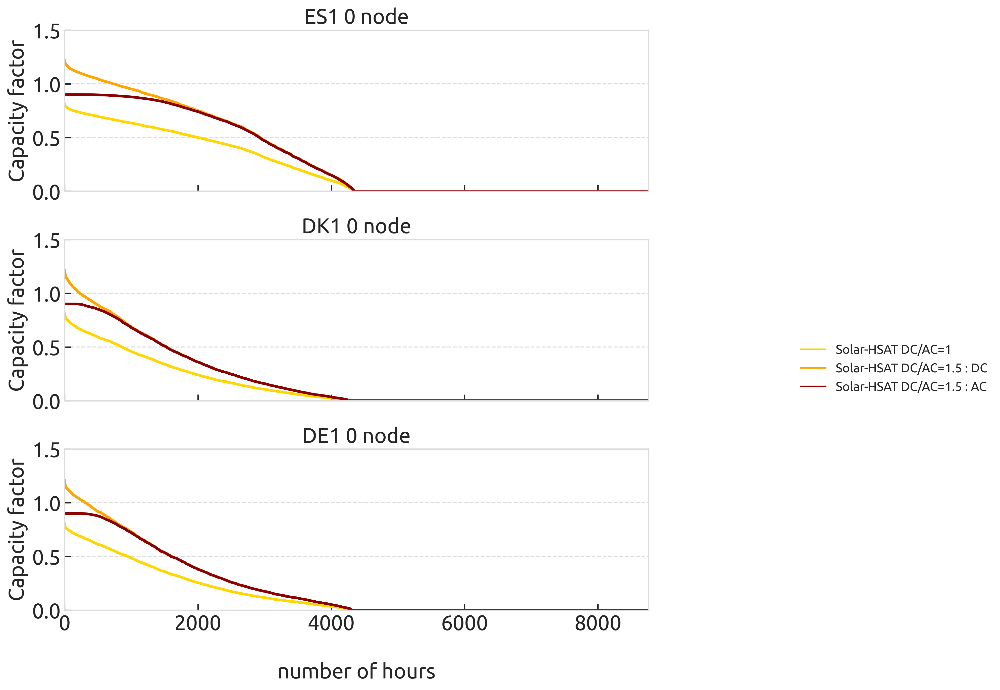

In [60]:
## solaar and solar with inverter duration curve

import matplotlib.ticker as mticker
from matplotlib.lines import Line2D
import copy

inverter_ratio=1.5

countries=['ES1 0','DK1 0','DE1 0']

fig, axs = plt.subplots(len(countries), 1, figsize=(10,10),sharex=True, sharey=True)  #5, 1, 
plt.rcParams['figure.dpi'] = 300
fig.subplots_adjust(hspace=0.3)

#      index=np.arange(len(results.columns))
style=['-','--']
for i in range(1):
   for j,country in enumerate(countries): 
     axs[j].grid(axis = 'y', zorder=0)   
        
     df = (n.generators_t.p_max_pu[[i for i in n.generators.index if   ##this is equal for n1 or n2
                                              n.generators.carrier[i]=='solar-hsat']].filter(like=country).sum(axis=1))  #GWh
     to_plot = df.sort_values(ascending=False).reset_index(drop=True)
     to_plot.index = [k / len(df) * 8760 for k in to_plot.index]
     axs[j].plot(to_plot,color='gold',linestyle=style[0], linewidth=2.5)
     #axs.set_facecolor("whitesmoke")

    
     df = df * 1.5
     to_plot = df.sort_values(ascending=False).reset_index(drop=True)
     to_plot.index = [k / len(df) * 8760 for k in to_plot.index]
     axs[j].plot(to_plot,color='orange',linestyle=style[0], linewidth=2.5)
     axs[j].set_title(country+' node', fontsize=12)
     #axs.set_facecolor("whitesmoke")
    

     df = (n.generators_t.p_max_pu.filter(like='solar-hsat-inv-1.5').filter(like=country).sum(axis=1))
     to_plot = df.sort_values(ascending=False).reset_index(drop=True)
     to_plot.index = [k / len(df) * 8760 for k in to_plot.index]
     axs[j].plot(to_plot,color='darkred',linestyle=style[0], linewidth=2.5)
     axs[j].set_title(country+' node', fontsize=20)  
        
     axs[j].axvline(0, linewidth=0.5, linestyle=":", color="grey")
     axs[j].axvline(8760, linewidth=0.5, linestyle=":", color="grey")
     axs[j].axhline(0, linewidth=0.5, linestyle=":", color="grey")
     axs[j].set_ylabel(ylabel="Capacity factor", fontsize=20) 
     axs[i].set_yticks(np.arange(0, 1.6, .5))
     plt.xlim(0,8760)
     axs[i].set_xticks(np.arange(0, 8001, 2000))
     plt.ylim(0,1.5)
        
axs[2].set_xlabel(xlabel='\nnumber of hours', fontsize=20)  

legend_manual=[]
labels=['Solar-HSAT DC/AC=1','Solar-HSAT DC/AC=1.5 : DC', 'Solar-HSAT DC/AC=1.5 : AC']

custom_lines = [Line2D([0], [0], color='gold', linestyle=style[0]),
                Line2D([0], [0], color='orange', linestyle=style[0]),
                Line2D([0], [0], color='darkred',linestyle=style[0])]

plt.legend(custom_lines, labels,loc='center right', bbox_to_anchor=(1.6, 1.5),ncol=1,
           fontsize=12, frameon=False) 
#axs.set_yticks(np.arange(-2, 10.1, 2),fontsize=24)
#axs.set_xticks(np.arange(0, 8001, 1000),fontsize=24)

#axs.xaxis.set_major_locator(1000)


## Supplementary figure 10

In [7]:
plt.rcParams['axes.facecolor'] = 'whitesmoke'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})

In [16]:
## new runs with alt. solar calculated in atlite : 2H resolution
main_scen= {
    'overnight_runs/postnetworks/elec_s370_37m_lv1.1__Co2L0p05-2H-T-H-I-solar+p2-dist1-highrooftop3-newsolar-allin_2050.nc':'Base'  ,
    'overnight_runs/postnetworks/elec_s370_37m_lv1.1__Co2L0p05-2H-T-H-I-solar+p2-dist1-EQc-highrooftop3-newsolar-allin_2050.nc':'Base w Equity'  ,
}

/home/parisr/tmp/ipykernel_1485/2112396009.py:58: UserWarning: FixedFormatter should only be used together with FixedLocator
  axs[j].set_xticklabels(labels,fontsize=8, rotation=30,ha='right', rotation_mode='anchor')
/home/parisr/tmp/ipykernel_1485/2112396009.py:58: UserWarning: FixedFormatter should only be used together with FixedLocator
  axs[j].set_xticklabels(labels,fontsize=8, rotation=30,ha='right', rotation_mode='anchor')


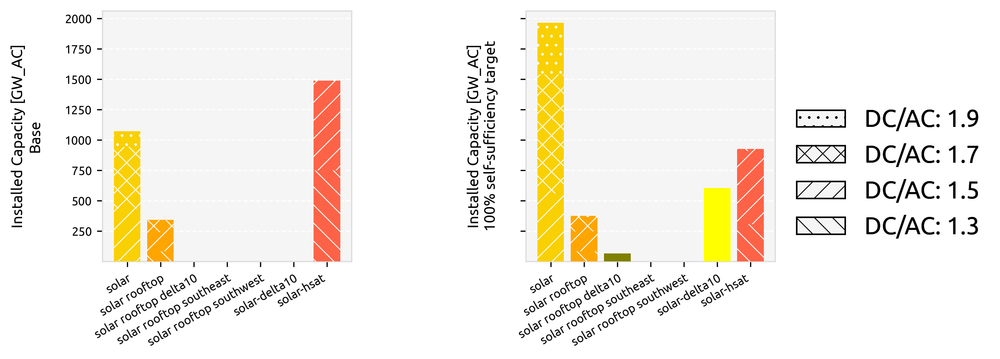

In [26]:
## All-in competition for sector-coupled

from matplotlib.patches import FancyArrowPatch
import matplotlib.font_manager
import matplotlib.lines as lines

plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='gainsboro')
plt.rcParams['hatch.linewidth'] = 0.6
plt.rcParams['figure.dpi'] = 300
plt.rcParams['hatch.color'] = 'white' 



fig, axs = plt.subplots(1,2,figsize=(8,3), sharey=True)
fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.7)

bar_width=0.25
hatches={'1.3':'\\\\', '1.5':'//', '1.7':'xx','1.9' : '..', } #'+', 'x', 'o', 'O', '.', '*']


for j, scenario in enumerate(main_scen.keys()):
         n=pypsa.Network(scenario)  
         axs[j].grid(axis='x')
         tech = (
             pd.Series([' '.join(i.split(' ')[2:]) for i in 
                  n.generators.filter(like='solar').index], 
                  index=n.generators.filter(like='solar').index)
                 )
         ggrouper= pd.Series(n.generators.filter(like='solar').index.map(tech), 
                             index=n.generators.filter(like='solar').index,)


         df_solar=pd.DataFrame(n.generators.p_nom_opt.filter(like='solar').groupby(ggrouper).sum())/1e3 ##GW
         #toplot=[i for i in df_solar.index if 'thermal' not in i]
         df_solar=df_solar.drop([i for i in df_solar.index if 'thermal' in i])
         df_solar['carrier']=df_solar.apply(lambda x: x.name.partition('-inv')[0], axis=1)
         df_solar=df_solar.groupby([ df_solar.carrier, df_solar.index]).sum()


         labels=[]
         toplot=set(df_solar.index.get_level_values(0))
         index=np.arange(len(toplot) )

         for i, carrier in enumerate(sorted(list(toplot))):
             labels.append(carrier)
             bottom=0
             for k, component in enumerate(df_solar.loc[carrier].index):
                hatch= hatches[component.partition('-inv-')[-1]] if 'inv' in component else None
                axs[j].bar(index[i], df_solar.loc[(carrier,component)], 
                      color=tech_colors[carrier],
                      hatch= hatch, 
                      bottom=bottom,
                          zorder=3)
                bottom+=df_solar.loc[(carrier,component)]
         if j<2 :
           axs[j].set_xticklabels(labels,fontsize=8, rotation=30,ha='right', rotation_mode='anchor')
           axs[j].set_xticks((index)) #++bar_width*0.5)    
           axs[j].set_xlabel("", rotation=0)
         #else:
           #axs[j].set_xticks([],[]) #++bar_width*0.5)    
           #axs[j].set_xlabel("", rotation=0)     
                
         axs[j].tick_params(axis='y', labelsize=8)
        
       
axs[0].set_ylabel('Installed Capacity [GW_AC]\n'+'Base'+'\n',fontsize=10, fontname = 'Ubuntu')
axs[1].set_ylabel('Installed Capacity [GW_AC]\n'+'100% self-sufficiency target'+'\n',fontsize=10, fontname = 'Ubuntu')

legend_manual=[]
for i, label in enumerate(['1.3','1.5','1.7','1.9']):
    legend_manual.append(mpatches.Patch(facecolor='whitesmoke', hatch=hatches[label], edgecolor='k', 
                                        label='DC/AC: '+label))
legend2=plt.legend(handles=legend_manual[::-1],loc='upper left', 
                   bbox_to_anchor=(1, 0.7),ncol=1,
           fontsize=16,frameon=False)
plt.gca().add_artist(legend2)

In [18]:
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['figure.facecolor'] = 'white'

plt.rcParams.update({"axes.grid" : True, "grid.color" :"white" , "grid.linestyle":"dashed"})

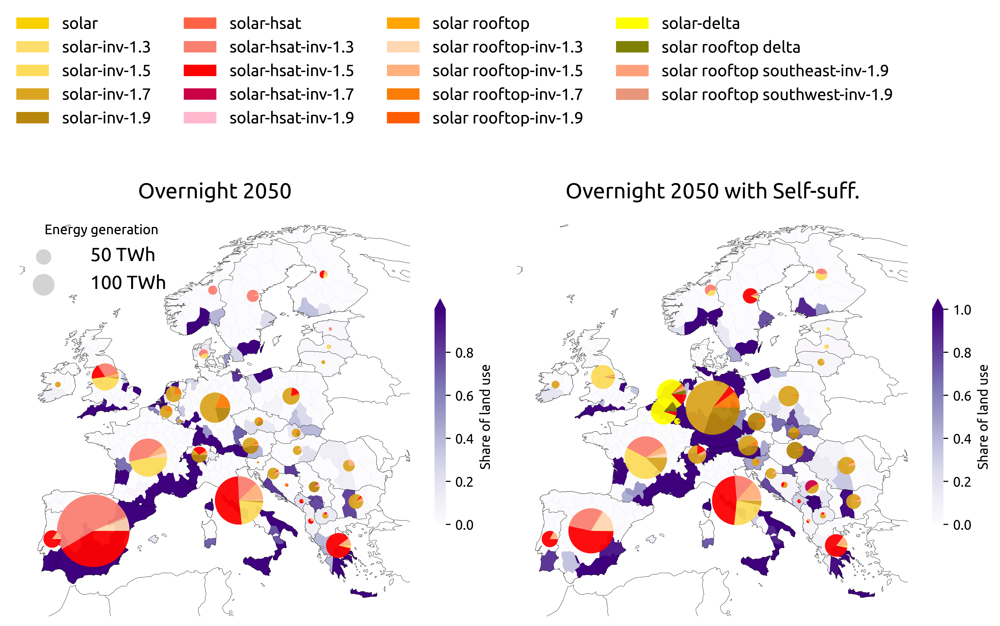

In [47]:
## generation map

## installed capacity map

from mpl_toolkits.axes_grid1.inset_locator import inset_axes
proj = ccrs.EqualEarth() #PlateCarree() #

fig,axs = plt.subplots(1,2,figsize=(13,6) , subplot_kw={"projection": proj}, dpi=600)   #or  ccrs.Orthographic() .Mercator
plt.rc('font',family='Ubuntu')
plt.rc('axes',edgecolor='None')
fig.subplots_adjust(wspace=0.02)

nodes = gpd.read_file('resources/regions_onshore_elec_s370.geojson').set_index("name")


n1=pypsa.Network('overnight_runs/postnetworks/elec_s370_37m_lv1.1__Co2L0p05-2H-T-H-I-solar+p2-dist1-highrooftop3-newsolar-allin_2050.nc')
n2=pypsa.Network('overnight_runs/postnetworks/elec_s370_37m_lv1.1__Co2L0p05-2H-T-H-I-solar+p2-dist1-EQc-highrooftop3-newsolar-allin_2050.nc')

land_use_factors= {
        'solar-delta' : 0.73  ,                                                                     
        'solar-hsat'  : 1.15 ,                                                                      
        }
bus_size_factor= 200
custom_colors= {'solar': '#f9d002',
 'solar-inv-1.3': '#fdde6c',
 'solar-inv-1.5': '#fddc5c',
 'solar-inv-1.7': 'goldenrod',
 'solar-inv-1.9': 'darkgoldenrod',
 'solar-hsat': 'tomato',
 'solar-hsat-inv-1.3': 'salmon',
 'solar-hsat-inv-1.5': '#fe0002',
 'solar-hsat-inv-1.7': '#ca0147',
 'solar-hsat-inv-1.9': '#ffb7ce',
 'solar rooftop': 'orange',
 'solar rooftop-inv-1.3': '#ffd8b1',
 'solar rooftop-inv-1.5': '#ffb07c',
 'solar rooftop-inv-1.7': '#fb7d07',
 'solar rooftop-inv-1.9': '#ff5b00',
 'solar-delta10': 'yellow',
 'solar rooftop delta10': 'olive',
 'solar rooftop southeast-inv-1.9': 'lightsalmon',
 'solar rooftop southwest-inv-1.9': 'darksalmon',
}


for c, n in enumerate([n1, n2]):
     
     geodf = nodes
     geodf = geodf.to_crs(proj.proj4_init)
     geodf.boundary.plot(ax=axs[c],zorder=1,edgecolor='black', linewidth= 0.1) 

     solar = [i for i in n.generators.index if 'solar' in i
                      and 'thermal' not in i and 'rooftop' not in i]#.groupby(n.generators.bus).sum()

     land_use = pd.DataFrame(1, index=solar, columns=['land_use_factor'])
     for key in land_use_factors.keys():
        land_use = land_use.apply(lambda x: (x*land_use_factors[key]) if key in x.name else x,  axis=1)

     dc_capacity = pd.DataFrame(1, index=solar, columns=['dc_capacity'])
     dc_capacity = dc_capacity.apply(lambda x: (x* float(x.name[x.name.find('inv-')+4:x.name.find('inv-')+7])) if 
                                'inv' in x.name else x,  axis=1)  
     location = (
        pd.Series([' '.join(i.split(' ')[:2]) for i in n.generators.index], index=n.generators.index)
        )
     ggrouper= pd.Series( n.generators.loc[solar].index.rename('bus').map(location), index=n.generators.loc[solar].index,)
     installed= pd.DataFrame((n.generators.p_nom_opt.loc[solar].values*land_use.squeeze().values*
                         dc_capacity.squeeze()).groupby(ggrouper).sum()).squeeze()

     ## FIX the p_nom_max for 2025?
     installed =(installed/n1.generators.p_nom_max[n1.generators.carrier=='solar'].values).reindex(geodf.index).fillna(0)

     geodf.plot(
        ax=axs[c],
        column=installed,
        # transform=ccrs.PlateCarree(),
        cmap="Purples",
        alpha=1,
        linewidths=0,
        #vmax=s.max(),
        legend=True,
        legend_kwds={"label": 'Share of land use', "shrink": 0.5, "extend": "max"},
     )  
     
     axs[c].add_feature(cartopy.feature.COASTLINE.with_scale("50m"), linewidth=0.2, zorder=2)
     axs[c].add_feature(cartopy.feature.BORDERS.with_scale("50m"), linewidth=0.2, zorder=2)
     
     geodf = gpd.read_file('resources/regions_onshore_elec_s370_37m.geojson').set_index("name")
     geodf = geodf.to_crs(proj.proj4_init)
     centroids = geodf.centroid
     solar=[i for i in n.generators.index if 'solar' in i and 'thermal' not in i]

     tech = ( pd.Series([' '.join(i.split(' ')[2:]) for i in 
          n.generators.loc[solar].index], index=n.generators.loc[solar].index))

     location = (pd.Series([i[:2] for i in n.generators.index], index=n.generators.index)) 

     ggrouper= pd.Series(n.generators.loc[solar].index.map(tech), 
                             index=n.generators.loc[solar].index,)

     shares= n.generators_t.p.loc[:,solar].sum().groupby([location, ggrouper]).sum()/1e6 #TWh

     for i, country in enumerate(set(shares.index.get_level_values(0))):
         node= [k for k in geodf.index if country in k][0] ##first element for countries with 2 nodes
         x_coord = centroids.loc[node].x
         y_coord = centroids.loc[node].y
         ax_sub = inset_axes(axs[c], width=0.4, height=0.4, loc=10, bbox_to_anchor=(x_coord, y_coord),
                        bbox_transform=axs[c].transData)
         ax_sub.pie(shares[country], 
               radius= ((shares[country].sum()/bus_size_factor)**.5),
               wedgeprops={'linewidth': 0,"alpha": 0.95}, colors=[custom_colors[carrier] for carrier in shares[country].index])
     

axs[0].set_title('Overnight 2050', fontsize=16)

axs[1].set_title('Overnight 2050 with Self-suff.', fontsize=16)


sizes = [50, 100]
labels = [f"{s} TWh" for s in sizes]
add_legend_circles(
             axs[0],
             sizes,
             labels,
             scale=bus_size_factor/3.14,
             srid=n.srid,
             legend_kw=dict(title="Energy generation", loc="upper left",
                            bbox_to_anchor=(0, 1), fontsize=14, frameon=False),
             patch_kw=dict(facecolor="lightgrey",),
              )


labels= sorted(list(set(shares.index.get_level_values(1))))
colors = [tech_colors[c] for c in labels]

add_legend_patch(
        axs[1],
        custom_colors.values(), #colors,
        [str(i).replace('10','') for i in custom_colors.keys()], #labels,
        patch_kw=dict(edgecolor="None"),
       legend_kw=dict(bbox_to_anchor=(1,1.5), ncol=4,fontsize=12,frameon=False),)

## Figure 1.c + Supplementary Figure 12 + Supplementary Figure 13

In [8]:
iso2name={'AT':'Austria',
          'BE':'Belgium',
          'BG':'Bulgaria',
          'CH':'Switzerland',
          'CZ':'Czechia',
          'DE':'Germany',
          'DK':'Denmark',
          'EE':'Estonia',
          'ES':'Spain',
          'FI':'Finland',
          'FR':'France',
          'GB':'UK', #'United Kingdom',
          'GR':'Greece',
          'HR':'Croatia',
          'HU':'Hungary',
          'IT':'Italy',
          'LT':'Lithuania',
          'LU':'Luxembourg',
          'LV':'Latvia',
          'NO':'Norway',
          'PL':'Poland',
          'PT':'Portugal',
          'RO':'Romania',
          'SE':'Sweden',
          'SI':'Slovenia',
          'SK':'Slovakia',
          'IE':'Ireland',
          'NL':'Netherlands',
          'ME':'Montenegro',
          'AL':'Albania',
          'BA':'Bosnia-Herz.', #'Bosnia and Herzegovina',
          'MK':'N.Macedonia', #'North Macedonia',
          'RS':'Serbia',}

In [9]:
import logging
import sys

import numpy as np
import pandas as pd
import pypsa
#from prepare_sector_network import prepare_costs

idx = pd.IndexSlice
logger = logging.getLogger(__name__)
opt_name = {"Store": "e", "Line": "s", "Transformer": "s"}


def assign_carriers(n):
    if "carrier" not in n.lines:
        n.lines["carrier"] = "AC"


def assign_locations(n):
    for c in n.iterate_components(n.one_port_components | n.branch_components):
        ifind = pd.Series(c.df.index.str.find(" ", start=4), c.df.index)
        for i in ifind.unique():
            names = ifind.index[ifind == i]
            c.df.loc[names, "location"] = "" if i == -1 else names.str[:i]
            
def calculate_nodal_costs(n, label, nodal_costs):
    # Beware this also has extraneous locations for country (e.g. biomass) or continent-wide (e.g. fossil gas/oil) stuff
    for c in n.iterate_components(
        n.branch_components | n.controllable_one_port_components ^ {"Load"}
    ):
        c.df["capital_costs"] = (
            c.df.capital_cost * c.df[opt_name.get(c.name, "p") + "_nom_opt"]
        )
        capital_costs = c.df.groupby(["location", "carrier"])["capital_costs"].sum()
        index = pd.MultiIndex.from_tuples(
            [(c.list_name, "capital") + t for t in capital_costs.index.to_list()]
        )
        nodal_costs = nodal_costs.reindex(index.union(nodal_costs.index))
        nodal_costs.loc[index, label] = capital_costs.values

        if c.name == "Link":
            p = c.pnl.p0.multiply(n.snapshot_weightings.generators, axis=0).sum()
        elif c.name == "Line":
            continue
        elif c.name == "StorageUnit":
            p_all = c.pnl.p.multiply(n.snapshot_weightings.generators, axis=0)
            p_all[p_all < 0.0] = 0.0
            p = p_all.sum()
        else:
            p = c.pnl.p.multiply(n.snapshot_weightings.generators, axis=0).sum()

        # correct sequestration cost
        if c.name == "Store":
            items = c.df.index[
                (c.df.carrier == "co2 stored") & (c.df.marginal_cost <= -100.0)
            ]
            c.df.loc[items, "marginal_cost"] = -20.0

        c.df["marginal_costs"] = p * c.df.marginal_cost
        marginal_costs = c.df.groupby(["location", "carrier"])["marginal_costs"].sum()
        index = pd.MultiIndex.from_tuples(
            [(c.list_name, "marginal") + t for t in marginal_costs.index.to_list()]
        )
        nodal_costs = nodal_costs.reindex(index.union(nodal_costs.index))
        nodal_costs.loc[index, label] = marginal_costs.values

    return nodal_costs



In [34]:
##  Base vs. Base W. Euity (2050 is Figure 1.c pf main text, other years in Figure S12)
main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2040.nc':'Base'  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_2040.nc':'Base w Equity'  ,

}

In [44]:
## New solar vs. New solar W. Euity (Figure S13) 
main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2040.nc':'Base'  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2040.nc':'Base w Equity'  ,

}

In [11]:
iso2name={'AT':'Austria',
          'BE':'Belgium',
          'BG':'Bulgaria',
          'CH':'Switzerland',
          'CZ':'Czechia',
          'DE':'Germany',
          'DK':'Denmark',
          'EE':'Estonia',
          'ES':'Spain',
          'FI':'Finland',
          'FR':'France',
          'GB':'United Kingdom',
          'GR':'Greece',
          'HR':'Croatia',
          'HU':'Hungary',
          'IT':'Italy',
          'LT':'Lithuania',
          'LU':'Luxembourg',
          'LV':'Latvia',
          'NO':'Norway',
          'PL':'Poland',
          'PT':'Portugal',
          'RO':'Romania',
          'SE':'Sweden',
          'SI':'Slovenia',
          'SK':'Slovakia',
          'IE':'Ireland',
          'NL':'Netherlands',
          'ME':'Montenegro',
          'AL':'Albania',
          'BA':'Bosnia and Herz.',
          'MK':'North Macedonia',
          'RS':'Serbia',}

In [12]:
rename={'battery':'Battery storage','battery charger':'Battery storage','battery discharger':'Battery storage',
                          'home battery':'Home battery storage','home battery charger':'Home battery storage','home battery discharger':'Home battery storage',                                                       
                          'offwind':'Offshore wind', 'offwind-ac':'Offshore wind','offwind-dc':'Offshore wind', 'onwind':'Onshore wind',
                          'AC':'Transmission lines'  , 'DC':'Transmission lines','ror': 'Run of river',
                          'hydro':'Hydroelectricity' , 'nuclear':'Nuclear','uranium':'Nuclear',
                          'solar':'Solar utility', 'solar rooftop':'Solar rooftop',
                          'electricity distribution grid' : 'Electricity distribution grid',
                           'PHS' : 'Pumped hydro storage', 'H2':'H2 storage',
                           'SMR':'Power to gas'  , 'SMR CC':'Power to gas','oil': 'Oil to power/heat',
                           'Fischer-Tropsch':'Power to liquid', 'methanolisation':'Power to liquid',
                           'Sabatier':'Power to gas', 'helmeth':'Power to gas', 'coal' : 'Coal', 'lignite' :'Coal',
                            "solar-delta": "Solar-delta",'Li ion':'EV battery',
                          }

In [45]:
## the final dataframe has some zero rows for transmission lines, H2 pipelines, EU methanl, co2 atmsphere (store)
## run of river is also zero in later years

label= 'capital+marginal'
countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])
df_price=pd.DataFrame({})

iterables = [main_scen.values(), countries]

for i, scenario in enumerate(main_scen.keys()):
    n=pypsa.Network(scenario)
    nodal_costs=pd.DataFrame({})
    
    assign_carriers(n)
    assign_locations(n)
    df= calculate_nodal_costs(n, label, nodal_costs)
    df=df.rename(rename, level=3)
    for ix in df.index.get_level_values(3) :   
                if 'resistive heater' in ix or 'heat pump' in ix :
                   df =df.rename(index={ix : 'Power to heat',})
                if  any(w in ix for w in ['gas', 'OCGT', 'CCGT'])  :
                   df =df.rename(index={ix:'Gas to power/heat',})
                if 'biomass' in ix :df =df.rename(index={ix:'Biomass',})
                if 'biogas' in ix :df =df.rename(index={ix:'Biogas',})
                if 'oil' in ix :df =df.rename(index={ix:'Oil to power/heat',})
                if 'solar thermal' in ix :df =df.rename(index={ix:'Solar thermal',})
                if 'water tank' in ix :df =df.rename(index={ix:'Heat storage',})
                #if 'biogas' in ix :df.rename(index={ix:'Biomass',})
                if 'solar-hsat' in ix :df =df.rename(index={ix:'Solar-HSAT',})
                if 'solar-inv' in ix :df =df.rename(index={ix:'Solar utility',})
                       
    
    if i==0 : df_countries_cost= pd.DataFrame(index=list(set(df.index.get_level_values(3))),
                               columns=pd.MultiIndex.from_product(iterables, names=["scenario", "country"]))
    for j,country in enumerate(countries):                
      df_temp=df[df.index.get_level_values(2).str.contains(country)]

      df_countries_cost.loc[:, (main_scen[scenario],country)] = df_temp.groupby(df_temp.index.get_level_values(3)).sum()[label]         



INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2040.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
/tmp/ipykernel_18457/3763779873.py:38: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries_cost.loc[:, (main_scen[scenario],country)] = df_temp.groupby(df_temp.index.get_level_values(3)).sum()[label]
/tmp/ipykernel_18457/3763779873.py:38: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries_cost.loc[:, (main_scen[scen

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2040.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
/tmp/ipykernel_18457/3763779873.py:38: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries_cost.loc[:, (main_scen[scenario],country)] = df_temp.groupby(df_temp.index.get_level_values(3)).sum()[label]
/tmp/ipykernel_18457/3763779873.py:38: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries_cost.loc[:, (main_scen[

/tmp/ipykernel_18457/158480383.py:92: UserWarning: FixedFormatter should only be used together with FixedLocator
  axs.set_xticklabels(xlabels,fontsize=14, rotation=45,ha='right', rotation_mode='anchor')


(-1.0, 33.0)

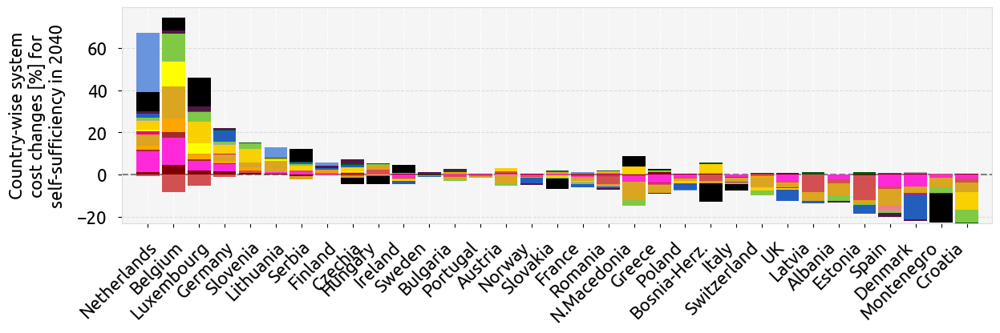

In [46]:
## Figure 1.c + Figure S12

fig, axs = plt.subplots( figsize=(14,3.5), sharey=True)


bar_width=0.9
axs.grid(axis = 'y',color='gainsboro', zorder=0)



index=np.arange(len(df_countries_cost['Base'].columns) )

country_order = ((df_countries_cost.sum()['Base']-df_countries_cost.sum()['Base w Equity'])/
                 df_countries_cost.sum()['Base w Equity']).sort_values().index
country_order_ = list(country_order)
total_cost_differece = (df_countries_cost['Base w Equity'].sum()-
                              df_countries_cost['Base'].sum())

total_cost_differece_percentage = (df_countries_cost['Base w Equity'].sum()-
                              df_countries_cost['Base'].sum())/ df_countries_cost['Base'].sum()


for i,country in enumerate(df_countries_cost['Base'].columns):
            bottom_p=0
            bottom_n=0
            
            bottom_p_2=0
            bottom_n_2=0
            index_country=  (country_order_).index(country)
            
            difference=(100*total_cost_differece_percentage.loc[country]*(df_countries_cost['Base w Equity'][country]-
                              df_countries_cost['Base'][country])/total_cost_differece.loc[country])
            
            
            for color, component in enumerate(list(difference.index)[::-1]):#df_countries_cost.index):
                 #difference=100* (df_countries_cost['Base w Equity'][country][component]-
                  #            df_countries_cost['Base'][country][component])/df_countries_cost['Base'][country][component]
            
                 if (abs(difference.sum())>1e4) :
                         if difference > 0 : 
                             axs.bar(index_country, difference.loc[component]
                                   , bar_width, 
                                   bottom=bottom_p,
                                   color=tech_colors[component], zorder=3)
                             bottom_p+=difference.loc[component]
                         elif difference < 0 :
                             #print(bottom_n)
                             axs.bar(index_country, difference.loc[component]
                                   , bar_width, 
                                   bottom=bottom_n,
                                   color=tech_colors[component], zorder=3)
                             bottom_n+=difference.loc[component]
                                
                 else :
                         if difference.loc[component] > 0 : 
                             axs.bar(index_country, difference.loc[component]
                                   , bar_width, 
                                   bottom=bottom_p_2,
                                   color=tech_colors[component], zorder=3)
                             bottom_p_2+=difference.loc[component]
                         elif difference.loc[component] < 0 :
                             #print(bottom_n)
                             axs.bar(index_country, difference.loc[component]
                                   , bar_width, 
                                   bottom=bottom_n_2,
                                   color=tech_colors[component], zorder=3)
                             bottom_n_2+=difference.loc[component]
                
            #axs.axvline(y=0,lw=1.5, color='black',zorder=4)
            #axs.set_xlabel("", rotation=0)
            #axs.set_xticks([], [])
            #axs.tick_params(axis='y', labelsize=18)
            #axs[i].set_facecolor("whitesmoke")
            #axs[i].set_yticks(np.arange(0, 401, 100),fontsize=25)
            #axs.set_ylabel('Installed capacity change [GW]\n',fontsize=20, fontname = 'Ubuntu')
            
legend_manual=[]
labels= [
 'Solar utility', 'Solar rooftop', 'solar-HSAT', 'solar-Delta','Onshore wind','Offshore wind','Nuclear','H2 Electrolysis','H2 Fuel Cell',
 'H2 pipeline','H2 storage','Heat storage','Battery storage','Home battery\nstorage',
 'Gas to power/heat','Oil to power/heat','Power to heat','Power to liquid','Biomass','Coal','DAC',]
#import textwrap
#[(' '.join(s.split(' ')[:3])+'\n'+' '.join(s.split(' ')[3:])) if s.count(' ')>2 else s for s in labels]
    
for key in (labels) : #sorted(list(df_countries_cost.index)[::-1])):
    legend_manual.append(mpatches.Patch(color=tech_colors[key.replace('\n',' ')], label=key))
plt.legend(handles=legend_manual,loc='upper right',  bbox_to_anchor=(0.5, -1),ncol=1,
           fontsize=12,frameon=False)
        
xlabels = [iso2name[i] for i in (country_order_)]        
#ylabels = [i for i in df_countries_cost['Base'].columns]
axs.set_xticklabels(xlabels,fontsize=14, rotation=45,ha='right', rotation_mode='anchor')
axs.set_xticks((index))    
axs.tick_params(axis='x', labelsize=16, pad=10,)

#axs.set_yticks(np.arange(-30, 101, 30),fontsize=14, ) 
#axs.set_yticks([-30, 0, 50, 100],fontsize=14, ) 
axs.tick_params(axis='y', labelsize=16, pad=10,)
axs.set_ylabel('Country-wise system\ncost changes [%] for\nself-sufficiency in 2040',fontsize=16, labelpad=10) 

#axs.tick_params(axis='x', colors='navy')

axs.axhline(y=0, color='grey', linestyle='--')

#axs.set_xlabel('Countries',fontsize=20, fontname = 'Ubuntu')
       

#fig.suptitle('cost changes for 100% equity [%]',fontsize=16, fontname = 'Ubuntu')
axs.set_xlim((-1,33))


## Supplementary Figure 14 + Supplementary Figure 15 + Supplementary Figure 16 + Supplementary Figure 17 + Supplementary Figure 18 +Supplementary Figure 19 +Supplementary Figure 20 + Supplementary Figure 21


In [6]:
import logging
import sys

import numpy as np
import pandas as pd
import pypsa
#from prepare_sector_network import prepare_costs

idx = pd.IndexSlice
logger = logging.getLogger(__name__)
opt_name = {"Store": "e", "Line": "s", "Transformer": "s"}


def assign_carriers(n):
    if "carrier" not in n.lines:
        n.lines["carrier"] = "AC"


def assign_locations(n):
    for c in n.iterate_components(n.one_port_components | n.branch_components):
        ifind = pd.Series(c.df.index.str.find(" ", start=4), c.df.index)
        for i in ifind.unique():
            names = ifind.index[ifind == i]
            c.df.loc[names, "location"] = "" if i == -1 else names.str[:i]
            
def calculate_nodal_capacities(n, label, nodal_capacities):
    # Beware this also has extraneous locations for country (e.g. biomass) or continent-wide (e.g. fossil gas/oil) stuff
    for c in n.iterate_components(
        n.branch_components | n.controllable_one_port_components ^ {"Load"}
    ):
        nodal_capacities_c = c.df.groupby(["location", "carrier"])[
            opt_name.get(c.name, "p") + "_nom_opt"
        ].sum()
        index = pd.MultiIndex.from_tuples(
            [(c.list_name,) + t for t in nodal_capacities_c.index.to_list()]
        )
        nodal_capacities = nodal_capacities.reindex(index.union(nodal_capacities.index))
        nodal_capacities.loc[index, label] = nodal_capacities_c.values

    return nodal_capacities



In [7]:
rename={'battery':'Battery store','battery charger':'Battery storage','battery discharger':'Battery storage',
                          'home battery':'Home battery store','home battery charger':'Home battery storage','home battery discharger':'Home battery storage',                                                       
                          'offwind':'Offshore wind', 'offwind-ac':'Offshore wind','offwind-dc':'Offshore wind', 'onwind':'Onshore wind',
                          'AC':'Transmission lines'  , 'DC':'Transmission lines','ror': 'Run of river',
                          'hydro':'Hydroelectricity' , 'nuclear':'Nuclear','uranium':'Nuclear',
                          'solar':'Solar utility', 'solar rooftop':'Solar rooftop',
                          'electricity distribution grid' : 'Electricity distribution grid',
                           'PHS' : 'Pumped hydro storage', 'H2':'H2 storage',
                           'SMR':'Power to gas'  , 'SMR CC':'Power to gas','oil': 'Oil to power/heat',
                           'Fischer-Tropsch':'Power to liquid', 'methanolisation':'Power to liquid',
                           'Sabatier':'Power to gas', 'helmeth':'Power to gas', 'coal' : 'Coal', 'lignite' :'Coal',
                            "solar-delta": "Solar-delta",'Li ion':'EV battery',
                          }

In [53]:
## Run for figures S14-S17 (a) : change BOTH years for network files
main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2050.nc':'Base'  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_2050.nc':'Base w Equity'  ,

}

In [65]:
## Run for figures S18-S21 (a) : change BOTH years for network files
main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc':'Base'  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc':'Base w Equity'  ,

}

In [66]:
label= 'capacity'
countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])
nodal_capacities=pd.DataFrame({})

iterables = [main_scen.values(), countries]

for i, scenario in enumerate(main_scen.keys()):
    n=pypsa.Network(scenario)
    nodal_capacities=pd.DataFrame({})
    
    assign_carriers(n)
    assign_locations(n)
    df= calculate_nodal_capacities(n, label, nodal_capacities)
    df=df.rename(rename, level=2)
    for ix in df.index.get_level_values(2) :   
                if 'resistive heater' in ix or 'heat pump' in ix :
                   df =df.rename(index={ix : 'Power to heat',})
                if 'biomass' in ix :df =df.rename(index={ix:'Biomass',})
                if  any(w in ix for w in ['gas ','OCGT', 'CCGT'])  : #'gas' would be storage, 'gas ' is everything else
                   df =df.rename(index={ix:'Gas to power/heat',}) 
                if 'biogas' in ix :df =df.rename(index={ix:'Biogas',})
                if 'oil' in ix :df =df.rename(index={ix:'Oil to power/heat',}) ##oil boilers, oil demand, etc.
                if 'solar thermal' in ix :df =df.rename(index={ix:'Solar thermal',})
                if 'water tank' in ix :df =df.rename(index={ix:'Heat storage',})
                #if 'biogas' in ix :df.rename(index={ix:'Biomass',})
                if 'solar-hsat' in ix :df =df.rename(index={ix:'Solar-HSAT',})
                if 'solar-inv' in ix :df =df.rename(index={ix:'Solar utility',})
                        
    
    if (i) ==0 : df_countries= pd.DataFrame(index=list(set(df.index.get_level_values(2))),
                               columns=pd.MultiIndex.from_product(iterables, names=["scenario", "country"]))
    for j,country in enumerate(countries):                
      df_temp=df[df.index.get_level_values(1).str.contains(country)]

      df_countries.loc[:, (main_scen[scenario],country)] = df_temp.groupby(df_temp.index.get_level_values(2)).sum()['capacity']         


df_countries_capacity=df_countries[df_countries.columns.sort_values(ascending=False)].fillna(0)# df_countries[sorted(df_countries.columns)].fillna(0)
df_countries_capacity=df_countries_capacity.rename({'gas':'gas storage'}) ##'gas' is also 'gas generators' which is local production+LNG but it's zero or very close to zero in all our networks


INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
/tmp/ipykernel_22359/1602526888.py:35: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries.loc[:, (main_scen[scenario],country)] = df_temp.groupby(df_temp.index.get_level_values(2)).sum()['capacity']
/tmp/ipykernel_22359/1602526888.py:35: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries.loc[:, (main_scen[scenario]

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
/tmp/ipykernel_22359/1602526888.py:35: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries.loc[:, (main_scen[scenario],country)] = df_temp.groupby(df_temp.index.get_level_values(2)).sum()['capacity']
/tmp/ipykernel_22359/1602526888.py:35: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries.loc[:, (main_scen[scena

/tmp/ipykernel_22359/1749783084.py:102: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ylabels,fontsize=14, rotation=45,ha='right', rotation_mode='anchor')


Text(0.5, 1.0, 'Installed power capacity\nchanges for other techs. [TW]\n2050')

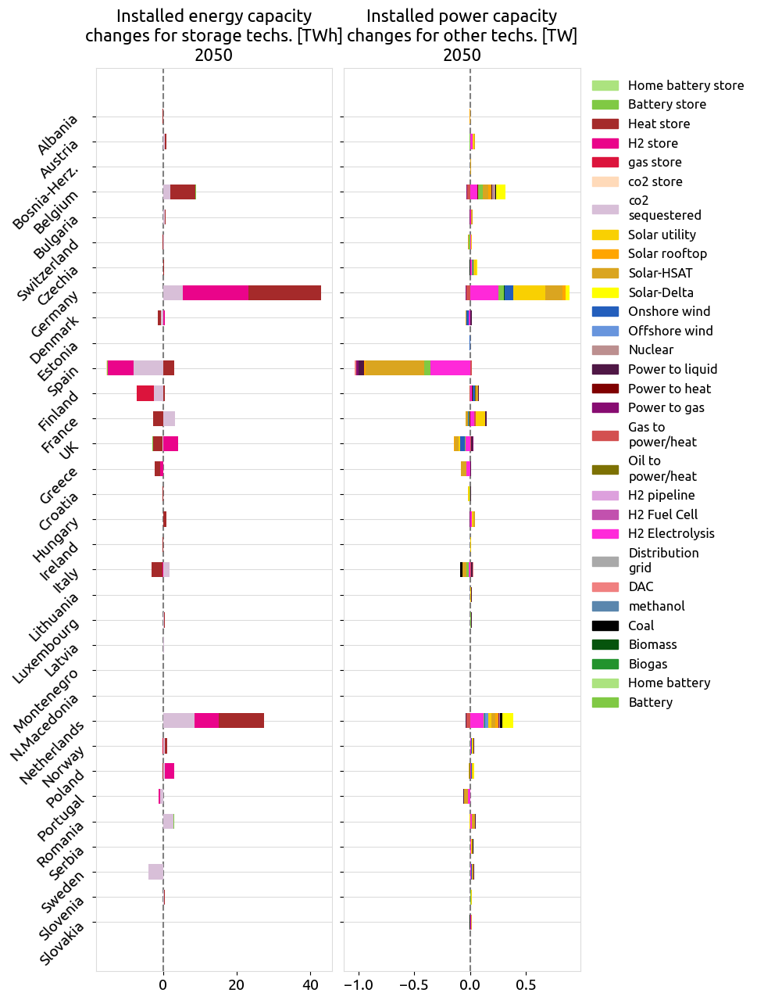

In [67]:
## for myopic 2050 base

fig, axs = plt.subplots(1,2, figsize=(8,15), sharey=True)


bar_width=0.6
axs[0].grid(axis = 'y',color='gainsboro', zorder=0)
axs[1].grid(axis = 'y',color='gainsboro', zorder=0)

fig.subplots_adjust(wspace=0.05)


index=np.arange(len(df_countries_capacity['Base'].columns) )

for i,country in enumerate(df_countries_capacity['Base'].columns):
            bottom_p=0
            bottom_n=0
            
            bottom_p_2=0
            bottom_n_2=0
             
            for color, component in enumerate(df_countries_capacity.index):
                 difference= (df_countries_capacity['Base w Equity'][country][component]-
                              df_countries_capacity['Base'][country][component])
            
                 #if (abs(difference)>1e4) :
                 if component in ['co2 sequestered','Heat storage','H2 storage','co2 stored','gas storage',
                                 'Battery store', 'Home battery store']:
                         if difference > 0 : 
                             axs[0].barh(index[i], difference/1e6 #TWh 
                                   , bar_width, 
                                   left=bottom_p,
                                   color=tech_colors[component], zorder=3)
                             bottom_p+=difference/1e6
                         elif difference < 0 :
                             #print(bottom_n)
                             axs[0].barh(index[i], difference/1e6 #Twh 
                                   , bar_width, 
                                   left=bottom_n,
                                   color=tech_colors[component], zorder=3)
                             bottom_n+=difference/1e6
                                
                 else :
                         if difference > 0 : 
                             axs[1].barh(index[i], difference/1e6 #TW
                                   , bar_width, 
                                   left=bottom_p_2,
                                   color=tech_colors[component], zorder=3)
                             bottom_p_2+=difference/1e6
                         elif difference < 0 :
                             #print(bottom_n)
                             axs[1].barh(index[i], difference/1e6 #TW
                                   , bar_width, 
                                   left=bottom_n_2,
                                   color=tech_colors[component], zorder=3)
                             bottom_n_2+=difference/1e6               
                


labels= {'Battery storage': 'Battery',
 'Home battery storage': 'Home battery',
 'Biogas': 'Biogas',
 'Biomass': 'Biomass',
 'Coal': 'Coal',
 'methanol': 'methanol',
 'DAC': 'DAC',
 'Electricity distribution grid': 'Distribution\ngrid',
 'H2 Electrolysis': 'H2 Electrolysis',
 'H2 Fuel Cell': 'H2 Fuel Cell',
 'H2 pipeline': 'H2 pipeline',
 #'gas pipeline': 'gas pipeline',
 'Oil to power/heat': 'Oil to\npower/heat',
 'Gas to power/heat': 'Gas to\npower/heat',
 #'Oil and gas to power/heat': 'Oil/Gas to\npower/heat',
 #'gas boilers': 'Gas boilers',
 'Power to gas': 'Power to gas',
 'Power to heat': 'Power to heat',
 'Power to liquid': 'Power to liquid',
 'Nuclear': 'Nuclear',
 'Offshore wind': 'Offshore wind',
 'Onshore wind': 'Onshore wind',
 'Solar-Delta': 'Solar-Delta',
 'Solar-HSAT': 'Solar-HSAT',
 'Solar rooftop': 'Solar rooftop',
 'Solar utility': 'Solar utility',
 'co2 sequestered': 'co2\nsequestered',
 'co2 stored': 'co2 store',
 'gas storage': 'gas store',
 'H2 storage': 'H2 store',
 'Heat storage': 'Heat store',
 'Battery store' : 'Battery store',
 'Home battery store' : 'Home battery store',     }

legend_manual=[]
for key in labels.keys(): #(sorted(df_countries_capacity.index)):
    legend_manual.append(mpatches.Patch(color=tech_colors[key], label=labels[key]))
plt.legend(handles=legend_manual[::-1],loc='upper left', bbox_to_anchor=(1, 1),ncol=1,
           fontsize=12,frameon=False)
        
ylabels = [iso2name[i] for i in df_countries_capacity['Base'].columns]
for ax in axs.reshape(-1):
  ax.set_yticklabels(ylabels,fontsize=14, rotation=45,ha='right', rotation_mode='anchor')
  ax.set_yticks((index))    
  ax.tick_params(axis='y', labelsize=14, pad=10,)
  ax.tick_params(axis='x', labelsize=14,)
  ax.axvline(x=0, color='grey', linestyle='--')

       
axs[0].set_title('Installed energy capacity\nchanges for storage techs. [TWh]\n2050',
                 fontsize=16, fontname = 'Ubuntu')
axs[1].set_title('Installed power capacity\nchanges for other techs. [TW]\n2050',
                 fontsize=16, fontname = 'Ubuntu')

#fig.suptitle('Installed capacity changes for Base 40% equity [TW-TWh]',fontsize=16, fontname = 'Ubuntu')



# import export

In [6]:
## Run for Figure 1.b and Figures S14-S17 (chnage both years in network names)
main_scen= {'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2050.nc':'Base',
           'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_2050.nc':'Base w Equity'}



In [87]:
## Run for Figures S18-S21 (chnage both years in network names)

main_scen= {'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-newsolar-cb29ex0_2050.nc':'Base',
           'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-newsolar-cb29ex0_2050.nc':'Base w Equity'}



In [14]:
## run
n=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_2050.nc')

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [8]:
countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])

location = (
        n.buses.location
        if "location" in n.buses.columns
        else pd.Series(n.buses.index, index=n.buses.index)
    )

def group(df, b="bus"):
        """
        Group given dataframe by bus location or country.

        The optional argument `b` allows clustering by bus0 or bus1 for
        lines and links.
        """
        if by_country:
            return df[b].map(location).map(n.buses.country) #.to_xarray()
        else:
            return df[b].map(location) #.to_xarray()

by_country=True #True



In [9]:

## final script for checking constraint

link_import_carriers_ = [
        # Pipeline imports / exports
        "H2 pipeline",
        "H2 pipeline retrofitted",
        "gas pipeline",
        "gas pipeline new",
        # Solid biomass
        "solid biomass transport",  ##not in model?
        # DC electricity
        "DC",
        # Oil (imports / exports between spatial nodes and "EU" node)
        "Fischer-Tropsch",          
        "biomass to liquid",      ##not in model?
        ##"residential rural oil boiler",
        ##"services rural oil boiler",
        ##"residential urban decentral oil boiler",
        ##"services urban decentral oil boiler",
        "oil",  # Oil powerplant (from `prepare_sector_network.add_generation`)
        # Gas (imports / exports between spatial nodes and "EU" node,
        # only cross-region if gas is not spatially resolved)
        "Sabatier",                 
        "helmeth",   ##not in model?
        ##"SMR CC",                ##in country with gas network
        ##"SMR",                ##in country with gas network
        ##"biogas to gas",       ##in country with gas network
        "BioSNG",                   ##not in model?
        "methanolisation",        ##added   
        "shipping methanol",
        ##"residential rural gas boiler",
        ##"services rural gas boiler",
        ##"residential urban decentral gas boiler",
        ##"services urban decentral gas boiler",
        ##"urban central gas boiler",
        ##"urban central gas CHP",
        ##"urban central gas CHP CC",
        ##"residential rural micro gas CHP",
        ##"services rural micro gas CHP",
        ##"residential urban decentral micro gas CHP",
        ##"services urban decentral micro gas CHP",
        "allam",
        ##"OCGT",
        ##"CCGT",
        ## Extra demands ?
        "shipping oil",
        "agriculture machinery oil",
        "land transport oil",
         "naphtha for industry", ##?
         "kerosene for aviation",  ##?
    ]
#df_countries= pd.DataFrame(index=countries,)

link_import_carriers = [
        # Pipeline imports / exports
        "H2 pipeline",
        "H2 pipeline retrofitted",
        "gas pipeline",
        "gas pipeline new",
        # Solid biomass
        "solid biomass transport",  ##not in model?
        # DC electricity
        "DC",
        "Sabatier",
        #"CO2 pipeline"

        # Oil (imports / exports between spatial nodes and "EU" node)
]
link_import_carriers_bus0= [
        "Fischer-Tropsch",          
       "methanolisation",          
] 
    
link_import_carriers_bus1= [
        "oil",  # Oil powerplant (from `prepare_sector_network.add_generation`)
        "shipping methanol",
        "agriculture machinery oil",
        "land transport oil",
         "shipping oil",  ##not calculated in previous method
         "naphtha for industry", ##?
         "kerosene for aviation",  ##?
         
]   
    



In [10]:
link_import_carriers_.append('AC')
link_import_carriers_.append('gas')
iterables = [main_scen.values(), link_import_carriers_]

df_countries= pd.DataFrame(index=[i for i in countries],
                      columns=pd.MultiIndex.from_product(iterables, names=["scenario", "carrier"])).sort_index()

In [12]:

## annual

for i, scenario in enumerate(main_scen.keys()):
    n=pypsa.Network(scenario)
    import_export_balances=pd.DataFrame({})
    ##AC 
    lines_cross_region_i = n.lines.loc[
        (group(n.lines, b="bus0") != group(n.lines, b="bus1")).to_numpy()
    ].index
    lines_in_s=n.generators_t.p.filter(like='onwind').groupby(n.generators.bus.map(location).map(n.buses.country),axis=1).sum()*0
    lines_in_s=(lines_in_s+(n.lines_t.p1
        .loc[:, lines_cross_region_i]
        .groupby(group(n.lines.loc[lines_cross_region_i], b="bus1"),axis=1)
        .sum())).fillna(0)
    lines_in_s_2=n.generators_t.p.filter(like='onwind').groupby(n.generators.bus.map(location).map(n.buses.country),axis=1).sum()*0
    lines_in_s_2=(lines_in_s_2+(
        n.lines_t.p0
        .loc[:, lines_cross_region_i]
        .groupby(group(n.lines.loc[lines_cross_region_i], b="bus0"),axis=1)
        .sum())
    ).fillna(0)
    line_imports = (lines_in_s+lines_in_s_2 ) #* n.snapshot_weightings.generators).sum("snapshot")
    df_countries.loc[:, (main_scen[scenario],'AC')]=line_imports.sum()
    ##gas 
    gas_import_i = n.generators.loc[n.generators.carrier == "gas"].index  
    if len(gas_import_i) > 0:
        gas_import_p = (
             n.generators_t.p
            .loc[:, gas_import_i]
            .groupby(group(n.generators.loc[gas_import_i]), axis=1)
            .sum()
        )
        gas_imports = (-1) * (gas_import_p) # make it an import
    else:
        gas_imports = None
    df_countries.loc[:, (main_scen[scenario],'gas')]=gas_imports.sum()
                        
    for link_carrier in link_import_carriers_bus0 :
  
        links_cross_region_i = (
        n.links.loc[(group(n.links, b="bus0") != group(n.links, b="bus1")).to_numpy()]  ##all EU->EU links (in case of not being spatially resolved) are disregarded
        .loc[n.links.carrier==link_carrier]
        .index
        )
        links_in_p = (
          (
       n.links_t.p1
        .loc[:, links_cross_region_i]
        .groupby(group(n.links.loc[links_cross_region_i], b="bus0"), axis=1)
        .sum()
        ))
        df_countries.loc[:, (main_scen[scenario],link_carrier)]= (-1)*(links_in_p).sum()

        
    for link_carrier in link_import_carriers_bus1 :
        links_cross_region_i = (
             n.links.loc[(group(n.links, b="bus0") != group(n.links, b="bus1")).to_numpy()]  ##all EU->EU links (in case of not being spatially resolved) are disregarded
            .loc[n.links.carrier==link_carrier].index )
        links_in_p = (
              (
             n.links_t.p1
              .loc[:, links_cross_region_i]
                .groupby(group(n.links.loc[links_cross_region_i], b="bus1"), axis=1)
                .sum()
               ) )

        df_countries.loc[:, (main_scen[scenario],link_carrier)]= (links_in_p).sum()
    
    for link_carrier in link_import_carriers :
  
        links_cross_region_i = (
        n.links.loc[(group(n.links, b="bus0") != group(n.links, b="bus1")).to_numpy()]  ##all EU->EU links (in case of not being spatially resolved) are disregarded
        .loc[n.links.carrier==link_carrier]
        .index
      )

        links_in_p = (
      (
        n.links_t.p1
            .loc[:, links_cross_region_i]
                .groupby(group(n.links.loc[links_cross_region_i], b="bus1"), axis=1)
                .sum()
            ) + (
           n.links_t.p0
                .loc[:, links_cross_region_i]
                .groupby(group(n.links.loc[links_cross_region_i], b="bus0"), axis=1)
                .sum()
            ))

        df_countries.loc[:, (main_scen[scenario],link_carrier)]= (links_in_p).sum()
    
df_countries=df_countries.fillna(0)
df_countries= df_countries* (8760/len(n.snapshots)) ###snapshot for correct numbers

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores
/tmp/ipykernel_22949/539888046.py:23: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries.loc[:, (main_scen[scenario],'AC')]=line_imports.sum()
/tmp/ipykernel_22949/539888046.py:36: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries.loc[:, (main_scen[scenario],'gas')]=gas_imports.sum()
/tmp/ipykernel_22949/539888046.py:52: D

/tmp/ipykernel_22949/539888046.py:67: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries.loc[:, (main_scen[scenario],link_carrier)]= (links_in_p).sum()
/tmp/ipykernel_22949/539888046.py:67: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df_countries.loc[:, (main_scen[scenario],link_carrier)]= (links_in_p).sum()
/tmp/ipykernel_22949/539888046.py:90: DeprecationWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[

/tmp/ipykernel_22894/345068997.py:69: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ylabels,fontsize=14, rotation=0,ha='center', rotation_mode='anchor')


Text(0.5, 0.98, 'Import-export balances for Base and 100% equity [PWh]')

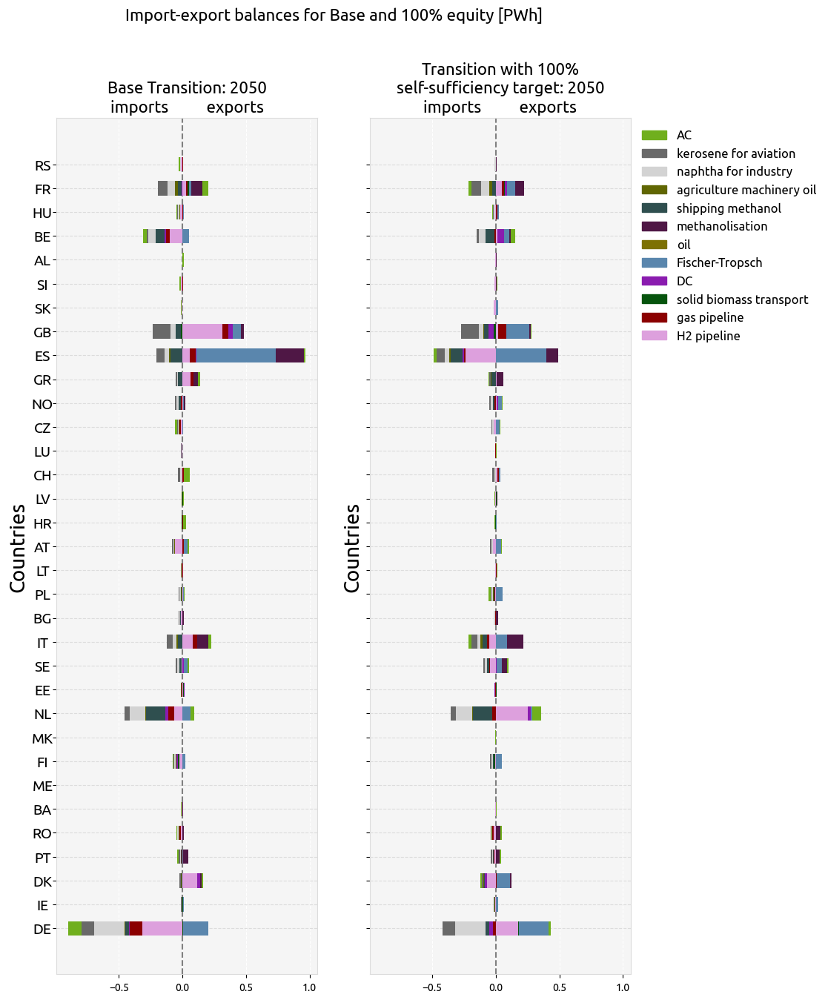

In [26]:
##2050 base : with kerosene and naphta
## attention : imports are negative!
fig, axs = plt.subplots(1,2, figsize=(10,15), sharey=True, sharex=True)


bar_width=0.6
axs[0].grid(axis = 'y',color='gainsboro', zorder=0)
axs[1].grid(axis = 'y',color='gainsboro', zorder=0)



index=np.arange(len(countries)) 

for i,country in enumerate(countries):
    # if abs(df_countries['Base w Equity'].loc[country]).sum()< 2e8: ##activate to see smaller countires better
            bottom_p=0
            bottom_n=0
            
            bottom_p_2=0
            bottom_n_2=0
                        
            for color, component in enumerate(link_import_carriers_):
              if df_countries.loc[:,('Base',component)].sum()!=0 :
                

                         if df_countries.loc[country,('Base',component)] > 0 : 
                             axs[0].barh(index[i], df_countries.loc[country,('Base',component)] /1e9 #GW 
                                   , bar_width, 
                                   left=bottom_p,
                                   color=tech_colors[component], zorder=3)
                             bottom_p+=df_countries.loc[country,('Base',component)] /1e9
                         else:
                             #print(bottom_n)
                             axs[0].barh(index[i], df_countries.loc[country,('Base',component)]/1e9 #GW 
                                   , bar_width, 
                                   left=bottom_n,
                                   color=tech_colors[component], zorder=3)
                             bottom_n+=df_countries.loc[country,('Base',component)]/1e9
                                
              if df_countries.loc[:,('Base w Equity',component)].sum()!=0 :
                         if df_countries.loc[country,('Base w Equity',component)]  > 0 : 
                             axs[1].barh(index[i], df_countries.loc[country,('Base w Equity',component)]/1e9 #GW 
                                   , bar_width, 
                                   left=bottom_p_2,
                                   color=tech_colors[component], zorder=3)
                             bottom_p_2+=df_countries.loc[country,('Base w Equity',component)]/1e9
                         else:
                             #print(bottom_n)
                             axs[1].barh(index[i], df_countries.loc[country,('Base w Equity',component)]/1e9 #GW 
                                   , bar_width, 
                                   left=bottom_n_2,
                                   color=tech_colors[component], zorder=3)
                             bottom_n_2+=df_countries.loc[country,('Base w Equity',component)]/1e9               
                

            
legend_manual=[]
for key in (link_import_carriers_):
  if df_countries.loc[:,('Base',key)].sum()!=0 :   
     legend_manual.append(mpatches.Patch(color=tech_colors[key], label=key))
plt.legend(handles=legend_manual[::-1],loc='upper left', bbox_to_anchor=(1, 1),ncol=1,
           fontsize=12,frameon=False)
        
axs[0].set_title('Base Transition: 2050\nimports          exports', fontsize=16) 
axs[1].set_title('Transition with 100%\nself-sufficiency target: 2050\nimports          exports',  fontsize=16 ) 
        
ylabels = [i for i in countries]
for ax in axs.reshape(-1):
  ax.set_yticklabels(ylabels,fontsize=14, rotation=0,ha='center', rotation_mode='anchor')
  ax.set_yticks((index))    
  ax.tick_params(axis='y', labelsize=14, pad=10,)

  #axs2.set_xticks(np.arange(-1.5, 1.1, 0.25),fontsize=25, ) 
  #axs.set_xticks(np.arange(-1.5*100, 1.1*100, 0.25*100),fontsize=25,) 

  #axs.tick_params(axis='x', colors='navy')

  ax.axvline(x=0, color='grey', linestyle='--')

  ax.set_ylabel('Countries',fontsize=20, fontname = 'Ubuntu')
       

fig.suptitle('Import-export balances for Base and 100% equity [PWh]',fontsize=16, fontname = 'Ubuntu')



/home/parisr/tmp/ipykernel_1485/4120356473.py:101: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ylabels,fontsize=14, rotation=45,ha='right', rotation_mode='anchor')


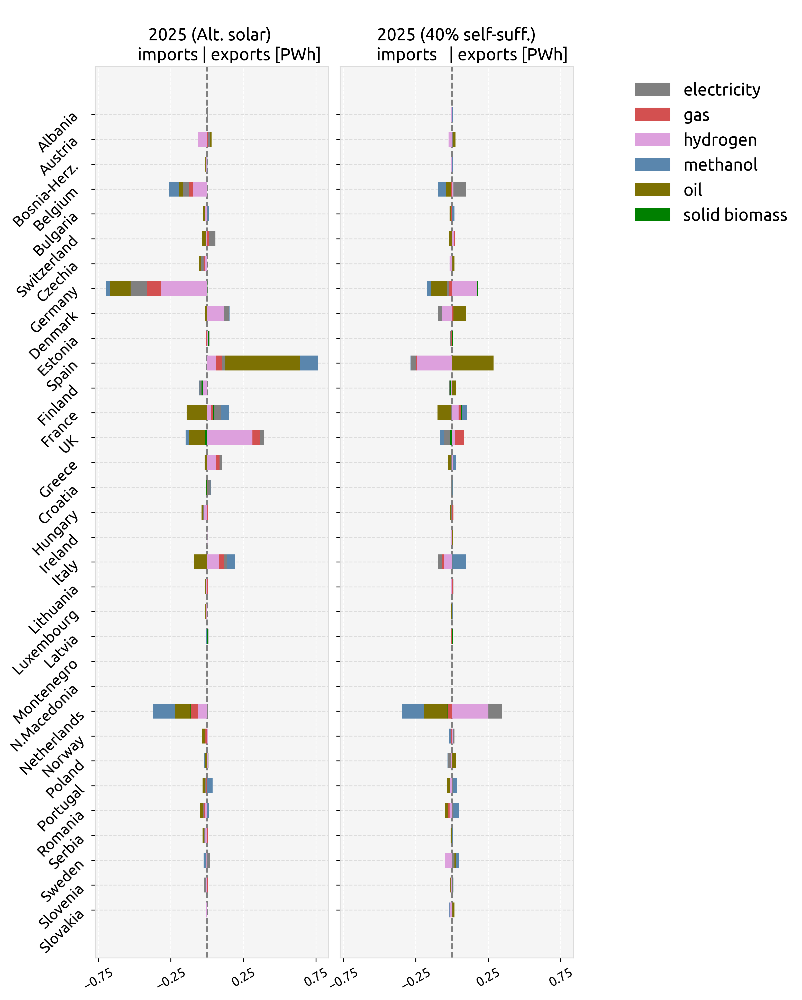

In [35]:
##Figure 1.b
#2050 base : with kerosene and naphta
## attention : imports are negative!
import copy
fig, axs = plt.subplots(1,2, figsize=(4,7), sharey=True, sharex=True, dpi=600)


bar_width=0.4
axs[0].grid(axis = 'y',color='gainsboro', zorder=0)
axs[1].grid(axis = 'y',color='gainsboro', zorder=0)


df_countries_ordered = df_countries.reindex((country_order))
to_drop=[]
lim=0.06
for country in (df_countries_ordered.index):
    if ( df_countries_ordered.loc[country,'Base'][df_countries_ordered.loc[country,'Base']>0].sum()/1e9 > lim or
          df_countries_ordered.loc[country,'Base'][df_countries_ordered.loc[country,'Base']<0].sum()/1e9 < -lim or
        df_countries_ordered.loc[country,'Base w Equity'][df_countries_ordered.loc[country,'Base w Equity']>0].sum()/1e9 > lim or
        df_countries_ordered.loc[country,'Base w Equity'][df_countries_ordered.loc[country,'Base w Equity']>0].sum()/1e9 < -lim):
        pass
    else:
        to_drop.append(country)

df_countries_ordered = df_countries_ordered.drop(labels=to_drop+['CZ','SE','FI'])
rename={'shipping methanol':'methanol','methanolisation':'methanol',
       'Fischer-Tropsch':'oil','kerosene for aviation':'oil', 'agriculture machinery oil':'oil',
        'naphtha for industry':'oil','land transport oil':'oil','shipping oil':'oil',
        'AC':'electricity', 'DC':'electricity',
        'H2 pipeline':'hydrogen', 'H2 pipeline retrofitted':'hydrogen',
        'gas pipeline':'gas', 'gas pipeline new':'gas',
        'solid biomass transport':'solid biomass'
       }
df_countries_ordered=df_countries_ordered.rename(columns=rename, level=1)

iterables = [main_scen.values(), df_countries_ordered.columns.get_level_values(1).unique()]
df_countries_simpl= pd.DataFrame(index=[i for i in df_countries_ordered.index],
                      columns=pd.MultiIndex.from_product(iterables, names=["scenario", "carrier"]))
df_countries_simpl['Base']= df_countries_ordered['Base'].groupby(level=0, axis = 1).sum()
df_countries_simpl['Base w Equity'] =  df_countries_ordered['Base w Equity'].groupby(level=0, axis = 1).sum()
carriers= df_countries_simpl.columns.get_level_values(1).unique()

index=np.arange(len(df_countries_simpl.index)) 

for i,country in enumerate(df_countries_simpl.index):
            bottom_p=0
            bottom_n=0
            
            bottom_p_2=0
            bottom_n_2=0
                        
            for color, component in enumerate(carriers):
              if df_countries_simpl.loc[:,('Base',component)].sum()!=0 :
                

                         if df_countries_simpl.loc[country,('Base',component)] > 0 : 
                             axs[0].barh(index[i], df_countries_simpl.loc[country,('Base',component)] /1e9 #GW 
                                   , bar_width, 
                                   left=bottom_p,
                                   color=tech_colors[component], zorder=3)
                             bottom_p+=df_countries_simpl.loc[country,('Base',component)] /1e9
                         else:
                             #print(bottom_n)
                             axs[0].barh(index[i], df_countries_simpl.loc[country,('Base',component)]/1e9 #GW 
                                   , bar_width, 
                                   left=bottom_n,
                                   color=tech_colors[component], zorder=3)
                             bottom_n+=df_countries_simpl.loc[country,('Base',component)]/1e9
                                
              if df_countries_simpl.loc[:,('Base w Equity',component)].sum()!=0 :
                         if df_countries_simpl.loc[country,('Base w Equity',component)]  > 0 : 
                             axs[1].barh(index[i], df_countries_simpl.loc[country,('Base w Equity',component)]/1e9 #GW 
                                   , bar_width, 
                                   left=bottom_p_2,
                                   color=tech_colors[component], zorder=3)
                             bottom_p_2+=df_countries_simpl.loc[country,('Base w Equity',component)]/1e9
                         else:
                             #print(bottom_n)
                             axs[1].barh(index[i], df_countries_simpl.loc[country,('Base w Equity',component)]/1e9 #GW 
                                   , bar_width, 
                                   left=bottom_n_2,
                                   color=tech_colors[component], zorder=3)
                             bottom_n_2+=df_countries_simpl.loc[country,('Base w Equity',component)]/1e9               
                

            
legend_manual=[]
for key in (carriers.sort_values()):
  if df_countries_simpl.loc[:,('Base',key)].sum()!=0 :   
     legend_manual.append(mpatches.Patch(color=tech_colors[key], label=key))
legend=plt.legend(handles=legend_manual,loc='upper left', bbox_to_anchor=(1.2, 1),ncol=1,
           fontsize=16,frameon=False,)# alignment ='right')
"""
renderer = fig.canvas.get_renderer()
shift = max([t.get_window_extent(renderer).width for t in legend.get_texts()])
for t in legend.get_texts():
    t.set_ha('right') # ha is alias for horizontalalignment
    temp_shift = shift - t.get_window_extent().width
    t.set_position((temp_shift,0))    
"""    

    
axs[0].set_title('2050 (Base) \nimports | exports\n[PWh]', fontsize=14) 
axs[1].set_title('2050 (100% self-suff.)\n  imports | exports\n[PWh]',  fontsize=14 ) 
        
ylabels = [iso2name[i] for i in df_countries_simpl.index]
for ax in axs.reshape(-1):
  ax.set_yticklabels(ylabels,fontsize=14, rotation=45,ha='right', rotation_mode='anchor')
  ax.set_yticks((index))    
  ax.tick_params(axis='y', labelsize=14, pad=10,)

  #axs2.set_xticks(np.arange(-1.5, 1.1, 0.25),fontsize=25, ) 
  #axs.set_xticks(np.arange(-1.5*100, 1.1*100, 0.25*100),fontsize=25,) 

  #axs.tick_params(axis='x', colors='navy')

  ax.axvline(x=0, color='grey', linestyle='--')

axs[0].set_xticks(np.arange(-0.75, 0.76, 0.5),fontsize=25, ) 
axs[0].tick_params(axis='x', labelsize=12,labelrotation=30 )

axs[1].set_xticks(np.arange(-0.75, 0.76, 0.5),fontsize=25, ) 
axs[1].tick_params(axis='x', labelsize=12,rotation=30)

       

#fig.suptitle('Import-export balances for Base and 100% equity [PWh]',fontsize=16, fontname = 'Ubuntu')



## Supplementary figure 28

In [11]:
## for 2050 myopic : base
main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2050.nc':'Base'  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-EQc-highrooftop3-cb29ex0_2050.nc':'Base w Equity'  ,

}

In [ ]:
## 100% suff. : import=export  : net_import + local_gen = load 
## suff = local-gen/load. = 1 - (net_import/load)

In [16]:
n=pypsa.Network(list(main_scen.keys())[0])

In [24]:
## most loads already in net_import calculation

load_carriers=([i for i in n.loads.carrier.unique() if i not in link_import_carriers_])# and 'process emissions' not in i]
load_carriers.remove('process emissions')
iterables_2 = [main_scen.values(), ['net_import', 'load']]


df_suff_time = pd.DataFrame(index=n.snapshots,
                         columns=pd.MultiIndex.from_product(iterables_2, names=["scenario", "parameter"]))

#df_countries= pd.DataFrame(index=[i for i in countries],
#                      columns=pd.MultiIndex.from_product(iterables, names=["scenario", "carrier"])).sort_index()

In [35]:
## attention: imports are negative and exports are positive

country_select='ES' ##


for i, scenario in enumerate(main_scen.keys()):
    n=pypsa.Network(scenario)
    import_export_balances=pd.DataFrame({})
    df_suff_time.loc[:,(main_scen[scenario], "load")]= (n.loads_t.p[[i for i in 
                n.loads.index if n.loads.carrier[i] in load_carriers]].filter(like=country_select).sum(axis=1))
    ##AC 
    lines_cross_region_i = n.lines.loc[
        (group(n.lines, b="bus0") != group(n.lines, b="bus1")).to_numpy()
    ].index
    lines_in_s=n.generators_t.p.filter(like='onwind').groupby(n.generators.bus.map(location).map(n.buses.country),axis=1).sum()*0
    lines_in_s=(lines_in_s+(n.lines_t.p1
        .loc[:, lines_cross_region_i]
        .groupby(group(n.lines.loc[lines_cross_region_i], b="bus1"),axis=1)
        .sum())).fillna(0)
    lines_in_s_2=n.generators_t.p.filter(like='onwind').groupby(n.generators.bus.map(location).map(n.buses.country),axis=1).sum()*0
    lines_in_s_2=(lines_in_s_2+(
        n.lines_t.p0
        .loc[:, lines_cross_region_i]
        .groupby(group(n.lines.loc[lines_cross_region_i], b="bus0"),axis=1)
        .sum())
    ).fillna(0)
    line_imports = (lines_in_s+lines_in_s_2 ) #* n.snapshot_weightings.generators).sum("snapshot")
    
    df_suff_time.loc[:,(main_scen[scenario], "net_import")]=line_imports[country_select]
    ##gas 
    gas_import_i = n.generators.loc[n.generators.carrier == "gas"].index  
    if len(gas_import_i) > 0:
        gas_import_p = (
             n.generators_t.p
            .loc[:, gas_import_i]
            .groupby(group(n.generators.loc[gas_import_i]), axis=1)
            .sum()
        )
        gas_imports = (gas_import_p) # * n.snapshot_weightings.generators).sum("snapshot")
    else:
        gas_imports = None
     
    df_suff_time.loc[:,(main_scen[scenario], "net_import")]+=gas_imports[country_select]

    for link_carrier in link_import_carriers_bus0 :
  
        links_cross_region_i = (
        n.links.loc[(group(n.links, b="bus0") != group(n.links, b="bus1")).to_numpy()]  ##all EU->EU links (in case of not being spatially resolved) are disregarded
        .loc[n.links.carrier==link_carrier]
        .index
        )
        links_in_p = (
          (
       n.links_t.p0
        .loc[:, links_cross_region_i]
        .groupby(group(n.links.loc[links_cross_region_i], b="bus0"), axis=1)
        .sum()
        ))

        if country_select in links_in_p.columns:
            #print(link_carrier)
            df_suff_time.loc[:,(main_scen[scenario], "net_import")]+=links_in_p[country_select]
            
    for link_carrier in link_import_carriers_bus1 :
        links_cross_region_i = (
             n.links.loc[(group(n.links, b="bus0") != group(n.links, b="bus1")).to_numpy()]  ##all EU->EU links (in case of not being spatially resolved) are disregarded
            .loc[n.links.carrier==link_carrier].index )
        links_in_p = (
              (
             n.links_t.p1
              .loc[:, links_cross_region_i]
                .groupby(group(n.links.loc[links_cross_region_i], b="bus1"), axis=1)
                .sum()
               ) )

        if country_select in links_in_p.columns:
            #print(link_carrier)
            df_suff_time.loc[:,(main_scen[scenario], "net_import")]+=links_in_p[country_select]
            
    for link_carrier in link_import_carriers :
  
        links_cross_region_i = (
        n.links.loc[(group(n.links, b="bus0") != group(n.links, b="bus1")).to_numpy()]  ##all EU->EU links (in case of not being spatially resolved) are disregarded
        .loc[n.links.carrier==link_carrier]
        .index
      )

        links_in_p = (
      (
        n.links_t.p1
            .loc[:, links_cross_region_i]
                .groupby(group(n.links.loc[links_cross_region_i], b="bus1"), axis=1)
                .sum()
            ) + (
           n.links_t.p0
                .loc[:, links_cross_region_i]
                .groupby(group(n.links.loc[links_cross_region_i], b="bus0"), axis=1)
                .sum()
            ))

        if country_select in links_in_p.columns:
            #print(link_carrier)
            df_suff_time.loc[:,(main_scen[scenario], "net_import")]+=links_in_p[country_select].fillna(0)
    
    df_suff_time.loc[:, (main_scen[scenario],'sufficiency')] = 100-100*((-1)*
                                                  df_suff_time.loc[:, (main_scen[scenario],'net_import')]
                                                   /df_suff_time.loc[:, (main_scen[scenario],'load')])

Text(0, 0.5, 'Share of local energy\nproduction from demand')

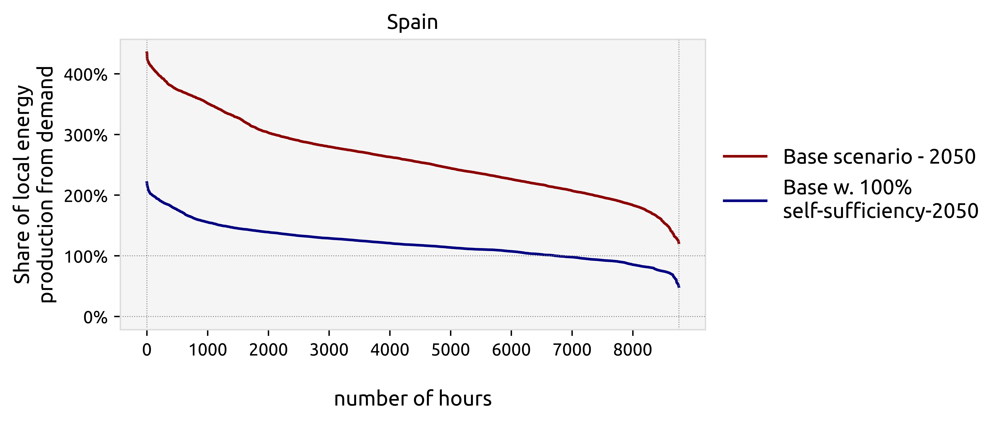

In [36]:
from matplotlib.ticker import PercentFormatter
import matplotlib.ticker as mticker
from matplotlib.lines import Line2D

fig, axs = plt.subplots(figsize=(6,3),sharex=True, sharey=False)  #5, 1, 
plt.rcParams['figure.dpi'] = 1000


style=['-','--']
df=df_suff_time.loc[:, ('Base','sufficiency')] 
to_plot = df.sort_values(ascending=False).reset_index(drop=True)
to_plot.index = [k / len(df) * 8760 for k in to_plot.index]
axs.plot(to_plot,color='darkred')

df=df_suff_time.loc[:, ('Base w Equity','sufficiency')]
to_plot = df.sort_values(ascending=False).reset_index(drop=True)
to_plot.index = [k / len(df) * 8760 for k in to_plot.index]
axs.plot(to_plot,color='navy', linestyle=style[0])

axs.set_title('Spain', fontsize=12)
axs.set_facecolor("whitesmoke")
axs.axvline(0, linewidth=0.5, linestyle=":", color="grey")
axs.axvline(8760, linewidth=0.5, linestyle=":", color="grey")
axs.axhline(0, linewidth=0.5, linestyle=":", color="grey")
axs.axhline(100, linewidth=0.5, linestyle=":", color="grey")

legend_manual=[]
labels=['Base scenario - 2050','Base w. 100% \nself-sufficiency-2050']

custom_lines = [Line2D([0], [0], color='darkred', linestyle=style[0]),
                Line2D([0], [0], color='navy',linestyle=style[0])]

plt.legend(custom_lines, labels,loc='center right', bbox_to_anchor=(1.5, 0.5),ncol=1,
           fontsize=12, frameon=False) 
#axs.set_yticks(np.arange(-2, 10.1, 2),fontsize=24)
axs.set_xticks(np.arange(0, 8001, 1000),fontsize=24)
axs.yaxis.set_major_formatter(PercentFormatter())

#axs.xaxis.set_major_locator(1000)
axs.set_xlabel(xlabel='\nnumber of hours', fontsize=12)  
axs.set_ylabel(ylabel="Share of local energy\nproduction from demand", fontsize=12)  



## Supplementary figure 34

In [7]:
import logging
import sys

import numpy as np
import pandas as pd
import pypsa
#from prepare_sector_network import prepare_costs

idx = pd.IndexSlice
logger = logging.getLogger(__name__)
opt_name = {"Store": "e", "Line": "s", "Transformer": "s"}


def assign_carriers(n):
    if "carrier" not in n.lines:
        n.lines["carrier"] = "AC"


def assign_locations(n):
    for c in n.iterate_components(n.one_port_components | n.branch_components):
        ifind = pd.Series(c.df.index.str.find(" ", start=4), c.df.index)
        for i in ifind.unique():
            names = ifind.index[ifind == i]
            c.df.loc[names, "location"] = "" if i == -1 else names.str[:i]

def calculate_nodal_supply_energy(n, label, nodal_supply_energy):
    """
    Calculate the total energy supply/consumption of each component at the buses
    aggregated by carrier and node.
    """

    bus_carriers = n.buses.carrier.unique()

    for i in bus_carriers:
        bus_map = n.buses.carrier == i
        bus_map.at[""] = False

        for c in n.iterate_components(n.one_port_components):
            items = c.df.index[c.df.bus.map(bus_map).fillna(False)]

            if len(items) == 0:
                continue

            s = (
                pd.concat([
                    (
                        c.pnl.p[items]
                        .multiply(n.snapshot_weightings.generators, axis=0)
                        .sum()
                        .multiply(c.df.loc[items, "sign"])
                    ),
                    c.df.loc[items][["bus", "carrier"]]
                ], axis=1)
                .groupby(by=["bus", "carrier"])
                .sum()[0]
            )
            s = pd.concat([s], keys=[c.list_name])
            s = pd.concat([s], keys=[i])

            nodal_supply_energy = nodal_supply_energy.reindex(s.index.union(nodal_supply_energy.index))
            nodal_supply_energy.loc[s.index, label] = s

        for c in n.iterate_components(n.branch_components):
            for end in [col[3:] for col in c.df.columns if col[:3] == "bus"]:
                items = c.df.index[c.df["bus" + str(end)].map(bus_map).fillna(False)]

                if (len(items) == 0) or c.pnl["p" + end].empty:
                    continue

                s = (
                    pd.concat([
                        (
                            (-1) * c.pnl["p" + end][[i for i in items if i in c.pnl["p" + end].columns]]#[items]
                            .multiply(n.snapshot_weightings.generators, axis=0)
                            .sum()
                        ),
                        c.df.loc[items][["bus0", "carrier"]]
                    ], axis=1)
                    .groupby(by=["bus0", "carrier"])
                    .sum()[0]
                )

                s.index = s.index.map(lambda x: (x[0], x[1] + end))
                s = pd.concat([s], keys=[c.list_name])
                s = pd.concat([s], keys=[i])

                nodal_supply_energy = nodal_supply_energy.reindex(
                    s.index.union(nodal_supply_energy.index)
                )

                nodal_supply_energy.loc[s.index, label] = s

    return nodal_supply_energy            
            
        'electricity',


In [17]:
rename={'battery':'Battery storage','battery charger':'Battery storage','battery discharger':'Battery storage',
                          'home battery':'Home battery storage','home battery charger':'Home battery storage','home battery discharger':'Home battery storage',                                                       
                           'offwind-ac':'Offshore wind','offwind':'Offshore wind','offwind-dc':'Offshore wind', 'onwind':'Onshore wind',
                          'AC':'Transmission lines'  , 'DC':'Transmission lines','ror': 'Run of river',
                          'hydro':'Hydroelectricity' , 'nuclear':'Nuclear','uranium':'Nuclear',
                          'solar':'Solar utility', 'solar rooftop':'Solar rooftop',
                          'electricity distribution grid' : 'Electricity distribution grid',
                           'PHS' : 'Pumped hydro storage', 'H2':'H2 storage',
                           'SMR':'Power to gas'  , 'SMR CC':'Power to gas','oil': 'Oil and gas to power/heat',
                           'Fischer-Tropsch':'Power to liquid', 'methanolisation':'Power to liquid',
                           'Sabatier':'Power to gas', 'helmeth':'Power to gas', 'coal' : 'Coal', 'lignite' :'Coal',
                           'Li ion':'EV battery' ,    "solar inv": "Solar utility",
                          "solar-hsat": "Solar-HSAT",
                          "solar-hsat inv": "Solar-HSAT",
                          "solar-delta": "Solar-Delta",
                          "solar-delta20": "Solar-Delta",

                          }

In [14]:
main_scen= {
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc':'2025'  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2030.nc':'2030'  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2040.nc':'2040'  ,
    'myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2050.nc':'2050'  ,

}

In [10]:
n=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2050.nc')

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2050.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


In [ ]:
## for demand
label= 'energy'
countries=set([i[:2] for i in n.buses.index if n.buses.carrier[i]=='AC'])

iterables = [main_scen.values(), countries]

for i, scenario in enumerate(main_scen.keys()):
    n=pypsa.Network(scenario)
    nodal_energy=pd.DataFrame({})
    
    assign_carriers(n)
    assign_locations(n)
    df= calculate_nodal_supply_energy(n, label, nodal_energy)
    #df=df.drop([i for i in (df[df.index.get_level_values(1)=='stores']).index.get_level_values(0)]) ## not really usefull
    df=df[df.index.get_level_values(1)=='loads'] ##comment out for production
    df=df.rename(rename, level=3)
    for ix in df.index.get_level_values(3) :   
                if 'resistive heater' in ix or 'heat pump' in ix :
                    df=df.rename({ix : 'Power to heat',})
                if 'biogas' in ix :df=df.rename({ix:'Biogas',})
                if  any(w in ix for w in ['boiler','CHP', 'OCGT', 'CCGT'])  :
                    df=df.rename({ix:'Oil and gas to power/heat',})
                #if 'boiler' in ix :df=df.rename({ix:'Oil and gas to heat',})
                #if 'CHP' in ix :df=df.rename({ix:'Oil and gas to power/heat',})
                if 'biomass' in ix :df=df.rename({ix:'Biomass',})
                if 'solar thermal' in ix :df=df.rename({ix:'Solar thermal',})
                if 'water tank' in ix :df=df.rename({ix:'Heat storage',})
                        
    
    for j,country in enumerate(countries):                
      df_temp=df[df.index.get_level_values(2).str.contains(country)]
      index_1 =df_temp.groupby(df_temp.index.get_level_values(3)).sum().index
      #index_list=set(list(index_1)+list(n.loads.carrier.unique()))

      if (i+j)==0:    df_countries_energy= pd.DataFrame(index= list(index_1),
                                columns=pd.MultiIndex.from_product(iterables, names=["scenario", "country"]))

      df_countries_energy.loc[:, (main_scen[scenario],country)] = df_temp.groupby(df_temp.index.get_level_values(3)).sum()['energy']         
      
      #for carrier in n.loads.carrier.unique():
       # if carrier not in index_1 :
        #    df_countries_energy.loc[carrier, (main_scen[scenario],country)] = (n.loads_t.p.loc[:,
         #   [i for i in n.loads.index if n.loads.carrier[i]==carrier]].filter(like=country).sum().sum())
            
df_countries_energy=(-1)*df_countries_energy.fillna(0)


In [19]:
## Demand evolution
from pypsa.plot import projected_area_factor
from matplotlib.patches import Circle, Ellipse, Patch
from matplotlib.legend_handler import HandlerPatch
from matplotlib.lines import Line2D
import cartopy.crs as ccrs
import cartopy
import geopandas as gpd
import logging
logger = logging.getLogger()
logger.setLevel(logging.CRITICAL)

    
plt.rcParams['figure.dpi'] = 1000
plt.rc('font',family='Ubuntu')
epsg = 3035
nodes = gpd.read_file('resources/regions_onshore_elec_s370_37m.geojson').set_index("name")
nodes["Area"] = nodes.to_crs(epsg=epsg).area.div(1e6)
    
fig,axs = plt.subplots(2,2, figsize=(13,13) , subplot_kw={"projection":ccrs.PlateCarree()})   #or  ccrs.Orthographic() .Mercator
fig.subplots_adjust(wspace=0.1)

base_color='powderblue'
line_width_factor=10 

node_names= list(nodes.index)

line_width_factor=2e3
bus_size_factor= 200
#toplot= df_countries_energy.loc[[i for i in df_countries_energy.index if i in demand],:].T.stack()
toplot= df_countries_energy.loc[[i for i in df_countries_energy.index if 'process' not in i],:].T.stack()

for c, scenario in enumerate(toplot.index.get_level_values(0).unique()):
  i = int(c/2)
  j= c%2
  shares= toplot[scenario]/1e6    ##TWh
  shares.rename(index=lambda x: [i for i in node_names if x in i][0], level=0, inplace=True)

  loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)    
    
  #shares.rename(index=lambda x: x.replace("FR1 0","FR1 3"), level=0, inplace=True)
  #shares.rename(index=lambda x: x.replace("DE1 0","DE1 2"), level=0, inplace=True)
  shares.rename(index=lambda x: x.replace("IT6 0","IT0 0"), level=0, inplace=True)
  shares.rename(index=lambda x: x.replace("ES3 0","ES0 0"), level=0, inplace=True) #11
  #shares.rename(index=lambda x: x.replace("GB4 0","GB5 0"), level=0, inplace=True)
  #shares.rename(index=lambda x: x.replace("NL0 0","NL1 1"), level=0, inplace=True)
  #shares.rename(index=lambda x: x.replace("CZ1 0","CZ1 1"), level=0, inplace=True)

  n.plot (ax=axs[i,j],
        bus_colors= tech_colors, #res, #{'p_nom_max':base_color,'p_nom_opt':carriers[carrier][0]},
        branch_components=["Line"],
        line_widths=n.lines.s_nom_opt/(line_width_factor),  #GW
        line_colors=loading,
        geomap=True,
        line_cmap='Blues',
        bus_sizes=shares/bus_size_factor)  #
    
  axs[i,j].axis('off')
  axs[i,j].set_extent([-10.53, 28.8, 35, 70])
  axs[i,j].set_title(scenario, fontsize= 14)

    
#axs[0].set_title('transition w new solar', fontsize=20)    
#axs[1].set_title('transition w new solar : 100% suff.',fontsize=20)   


sizes = [100, 200]
labels = [f"{s} TWh" for s in sizes]
add_legend_circles(
             axs[0,0],
             sizes,
             labels,
             scale=bus_size_factor,
             srid=n.srid,
             legend_kw=dict(title="Energy generation", loc="upper left",fontsize=12, frameon=False),
             patch_kw=dict(facecolor="lightgrey",),
         )

labels= set(shares.index.get_level_values(1))
colors = [tech_colors[c] for c in labels]

add_legend_patch(
        axs[0,1],
        colors,
        labels,
        patch_kw=dict(edgecolor="None"),
        legend_kw=dict(loc='right',bbox_to_anchor=(1.6, 0.5), ncol=1,fontsize=10,frameon=False),)


#cmap = plt.get_cmap('Blues') 
#norm = matplotlib.colors.Normalize(vmin=loading.min(), vmax=loading.max())
#cbar= fig.colorbar(cm.ScalarMappable(norm=norm, cmap=cmap), ax=axs[1,1], fraction=0.02, pad=0.5)
#cbar.ax.tick_params(labelsize=12)
#cbar.ax.set_title('Line loading')
#plt.savefig("potential_maps.png", dpi=1000)    

/home/parisr/miniconda3/envs/pypsa-eur-masters/lib/python3.10/site-packages/cartopy/mpl/style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


## Suuplementary figure 3, Suuplementary figure 33, and Suuplementary figure 33 are produced by the make_summary script of pypsa-Eur usinf csv tables for each network. The 'make_summary' script is available in the scripts folder of this repository and the csv files are all available at the zenodo (refer to README)

INFO:pypsa.io:Imported network elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units, stores


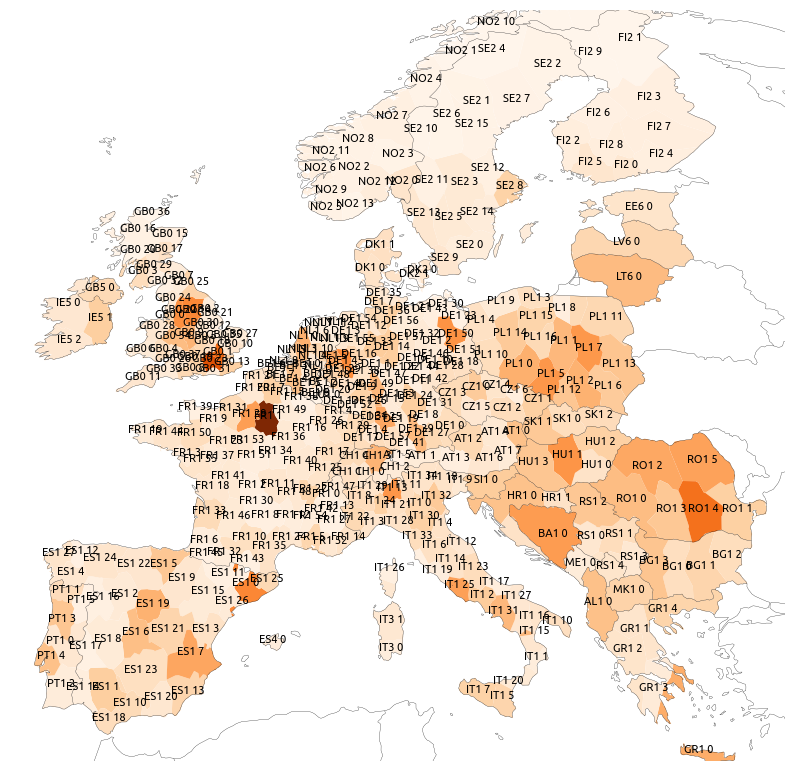

In [16]:
## node locations

import cartopy.crs as ccrs
import cartopy
import geopandas as gpd
epsg = 3035

n=pypsa.Network('myopic_runs/postnetworks/elec_s370_37m_lv1.1__2H-T-H-B-I-A-solar+p2-dist1-highrooftop3-cb29ex0_2025.nc')

geodf = gpd.read_file('resources/regions_onshore_elec_s370.geojson').set_index("name")
nodes = gpd.read_file('resources/regions_onshore_elec_s370.geojson').set_index("name")
nodes["Area"] = nodes.to_crs(epsg=epsg).area.div(1e6)

cmap="Oranges"
proj = ccrs.EqualEarth()
geodf = geodf.to_crs(proj.proj4_init)

fig, axs = plt.subplots(1, figsize = (10,10), subplot_kw={"projection": proj})

nuclear = (pd.Series((n.links.p_nom_opt.groupby([n.links.carrier , n.links.bus1.map(n.buses.location)])
   .sum()['nuclear']),nodes.index).fillna(0))


rooftop=[i for i in n.generators.index
            if  'solar rooftop' in i ]
location = (
        pd.Series([' '.join(i.split(' ')[:2]) for i in n.generators.index], index=n.generators.index)
        ) 
rooftop = s=pd.Series((n.generators.loc[rooftop].p_nom_max.groupby([n.generators.carrier , n.generators.loc[rooftop].index.map(location)]
           ).sum())['solar rooftop'] ,geodf.index).fillna(0)

lim = max(rooftop)
       
geodf.plot(
        column=rooftop,
        ax=axs,
        cmap=cmap,
        linewidths=0,
        legend=False,
        vmax=lim,
        vmin=0,
             )

geodf['coords'] = geodf['geometry'].apply(lambda x: x.representative_point().coords[:])
geodf['coords'] = [coords[0] for coords in geodf['coords']]
for idx, row in geodf.iterrows():
    axs.annotate(text=idx, xy=row['coords'],
                 horizontalalignment='center',fontsize=8)

axs.add_feature(cartopy.feature.COASTLINE.with_scale("50m"), linewidth=0.2, zorder=2)
axs.add_feature(cartopy.feature.BORDERS.with_scale("50m"), linewidth=0.2, zorder=2)
#GeoAxes.spines['geo'].outline_patch.set_visible(False)
axs.set_facecolor("white")
axs.set_extent([-10.53, 28.8, 35, 70])
axs.axis('off')
 
plt.show()